In [30]:
import warnings
warnings.filterwarnings('ignore')

import nltk
nltk.download('punkt')
nltk.download('omw-1.4')
nltk.download('averaged_perceptron_tagger')
from nltk.tokenize import word_tokenize
from nltk import pos_tag
nltk.download('stopwords')
from nltk.corpus import stopwords
stops = set(stopwords.words('english'))
stops -= {"hasn't",'haven','needn','wasn','not','couldn','aren',"won't",'isn','ain',"should've",'does','mightn','nor',"don't",'doesn',"shouldn't",'should', "weren't",'hasn','wouldn', 'hadn','no', 'don', 'be', "haven't","hadn't", "needn't","mightn't","couldn't","aren't", "didn't", "mustn't", 'didn', "wasn't",'weren','were',"isn't",'mustn',"shan't", 'shouldn', 'are', "doesn't",'being','did','do','doing', "wouldn't",}
nltk.download('wordnet')
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
import gzip

import re
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from wordcloud import WordCloud, STOPWORDS

from sklearn.feature_extraction.text import TfidfVectorizer
import matplotlib.cm as cm
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier
from sklearn.naive_bayes import MultinomialNB
# !pip install imblearn
# !pip install xgboost
#from imblearn.over_sampling import SMOTE
#from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from statistics import mean
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, cross_val_score, cross_val_predict, train_test_split, StratifiedKFold
from sklearn.metrics import f1_score, classification_report, confusion_matrix

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller
from tqdm import tqdm_notebook
from itertools import product
from statsmodels.tsa.arima.model import ARIMA 
from sklearn.metrics import mean_squared_error

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ftt\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\ftt\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\ftt\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ftt\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\ftt\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [15]:
def parse(path):
    g = gzip.open(path, 'rb')
    for l in g:
        yield eval(l)

def getDF(path):
    i = 0
    df = {}
    for d in parse(path):
        df[i] = d
        i += 1
    return pd.DataFrame.from_dict(df, orient='index')

g_df = getDF("D:/divya_dsft_7/capstone_project/capstone/reviews_Grocery_and_Gourmet_Food_5.json.gz")
hk_df = getDF("D:/divya_dsft_7/capstone_project/capstone/reviews_Home_and_Kitchen_5.json.gz")

g_df.to_csv('raw_g.csv')
hk_df.to_csv('raw_hk.csv')

In [16]:
df_g = g_df.copy()
df_hk = hk_df.copy()

In [17]:
df_g.head()

,reviewerID,asin,reviewerName,helpful,reviewText,overall,summary,unixReviewTime,reviewTime
0,A1VEELTKS8NLZB,616719923X,Amazon Customer,"[0, 0]",Just another flavor of Kit Kat but the taste i...,4.0,Good Taste,1370044800,"06 1, 2013"
1,A14R9XMZVJ6INB,616719923X,amf0001,"[0, 1]",I bought this on impulse and it comes from Jap...,3.0,"3.5 stars, sadly not as wonderful as I had hoped",1400457600,"05 19, 2014"
2,A27IQHDZFQFNGG,616719923X,Caitlin,"[3, 4]",Really good. Great gift for any fan of green t...,4.0,Yum!,1381190400,"10 8, 2013"
3,A31QY5TASILE89,616719923X,DebraDownSth,"[0, 0]","I had never had it before, was curious to see ...",5.0,Unexpected flavor meld,1369008000,"05 20, 2013"
4,A2LWK003FFMCI5,616719923X,Diana X.,"[1, 2]",I've been looking forward to trying these afte...,4.0,"Not a very strong tea flavor, but still yummy ...",1369526400,"05 26, 2013"


In [18]:
df_hk.head()

,reviewerID,asin,reviewerName,helpful,reviewText,overall,summary,unixReviewTime,reviewTime
0,APYOBQE6M18AA,0615391206,Martin Schwartz,"[0, 0]",My daughter wanted this book and the price on ...,5.0,Best Price,1382140800,"10 19, 2013"
1,A1JVQTAGHYOL7F,0615391206,Michelle Dinh,"[0, 0]",I bought this zoku quick pop for my daughterr ...,5.0,zoku,1403049600,"06 18, 2014"
2,A3UPYGJKZ0XTU4,0615391206,mirasreviews,"[26, 27]",There is no shortage of pop recipes available ...,4.0,"Excels at Sweet Dessert Pops, but Falls Short ...",1367712000,"05 5, 2013"
3,A2MHCTX43MIMDZ,0615391206,"M. Johnson ""Tea Lover""","[14, 18]",This book is a must have if you get a Zoku (wh...,5.0,Creative Combos,1312416000,"08 4, 2011"
4,AHAI85T5C2DH3,0615391206,PugLover,"[0, 0]",This cookbook is great. I have really enjoyed...,4.0,A must own if you own the Zoku maker...,1402099200,"06 7, 2014"


In [19]:
# =============================================================================
# data description
# =============================================================================
def desc(df):
    return (df.shape, df.describe())

print(desc(df_g))
print(desc(df_hk))

((151254, 9), <bound method NDFrame.describe of             reviewerID        asin  \
0       A1VEELTKS8NLZB  616719923X   
1       A14R9XMZVJ6INB  616719923X   
2       A27IQHDZFQFNGG  616719923X   
3       A31QY5TASILE89  616719923X   
4       A2LWK003FFMCI5  616719923X   
...                ...         ...   
151249  A2L6QS8SVHT9RG  B00KCJRVO2   
151250   AFJFXN42RZ3G2  B00KCJRVO2   
151251   ASEBX8TBYWQWA  B00KCJRVO2   
151252   ANKQGTXHREOI5  B00KCJRVO2   
151253  A2CF66KIQ3RKX3  B00KCJRVO2   

                                            reviewerName helpful  \
0                                        Amazon Customer  [0, 0]   
1                                                amf0001  [0, 1]   
2                                                Caitlin  [3, 4]   
3                                           DebraDownSth  [0, 0]   
4                                               Diana X.  [1, 2]   
...                                                  ...     ...   
151249             

In [20]:
df_g.isnull().sum()

reviewerID           0
asin                 0
reviewerName      1493
helpful              0
reviewText           0
overall              0
summary              0
unixReviewTime       0
reviewTime           0
dtype: int64

In [21]:
df_hk.isnull().sum()

reviewerID           0
asin                 0
reviewerName      4953
helpful              0
reviewText           0
overall              0
summary              0
unixReviewTime       0
reviewTime           0
dtype: int64

### EDA on raw data

In [22]:
df_g.dtypes

reviewerID         object
asin               object
reviewerName       object
helpful            object
reviewText         object
overall           float64
summary            object
unixReviewTime      int64
reviewTime         object
dtype: object

In [23]:
df_hk.dtypes

reviewerID         object
asin               object
reviewerName       object
helpful            object
reviewText         object
overall           float64
summary            object
unixReviewTime      int64
reviewTime         object
dtype: object

In [25]:
def todatetime(df):
    df['unixReviewTime'] = pd.to_datetime(df['unixReviewTime'])
    df['reviewTime'] = pd.to_datetime(df['reviewTime'])
    return df

df_g = todatetime(df_g)
df_hk = todatetime(df_hk)

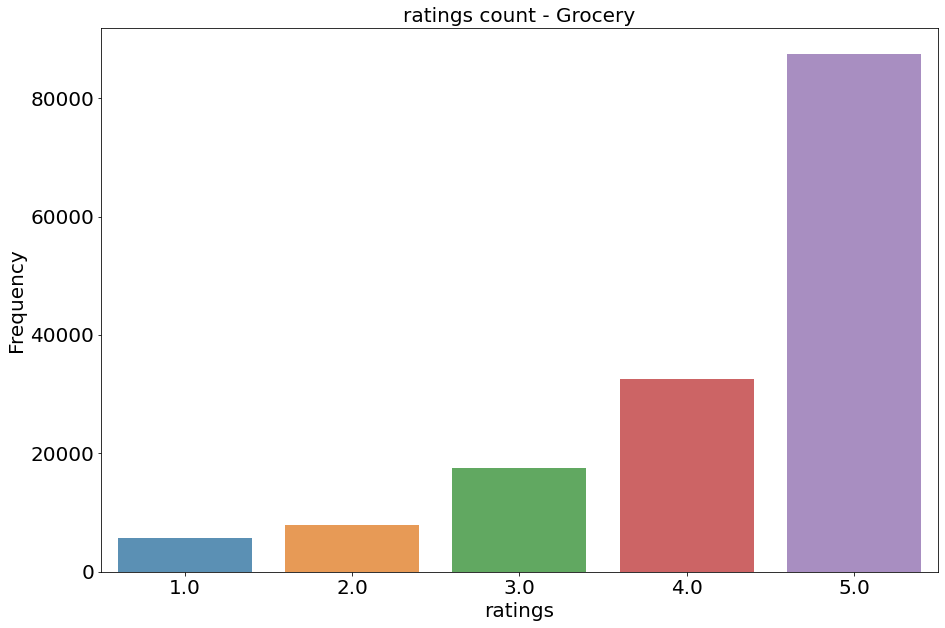

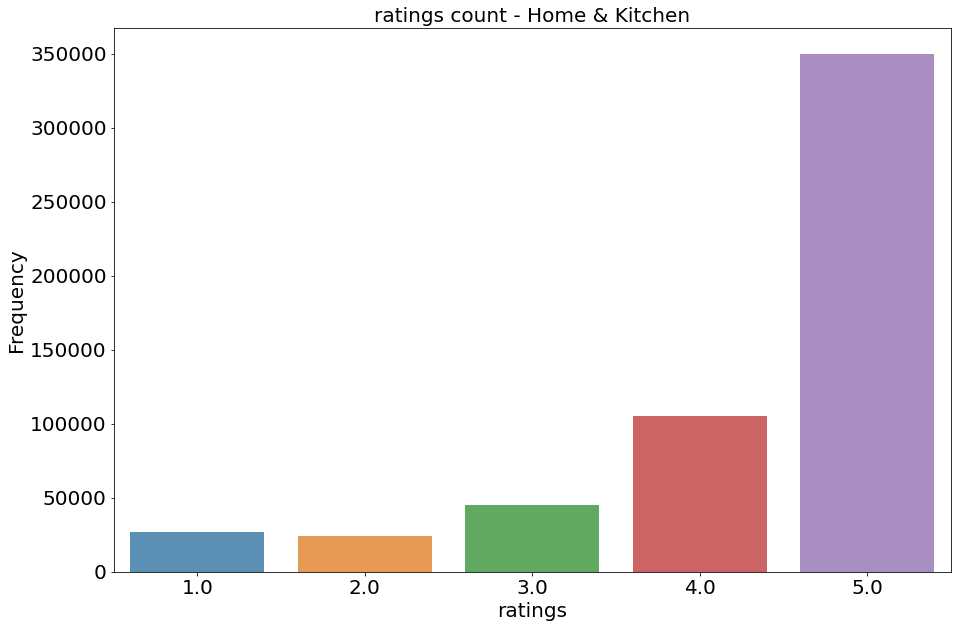

In [29]:
def count(df,col,data):
    x_rating = df[col].value_counts()
    y_rating = x_rating.sort_index()
    plt.figure(figsize=(15,10))
    sns.barplot(x_rating.index, x_rating.values, alpha=0.8)
    plt.title(col + " count - " + data, fontsize=20)
    plt.ylabel('Frequency', fontsize=20)
    plt.yticks(fontsize=20)
    plt.xlabel(col, fontsize=20)
    plt.xticks(fontsize=20)
    
count(df_g,'ratings','Grocery')
count(df_hk,'ratings','Home & Kitchen')

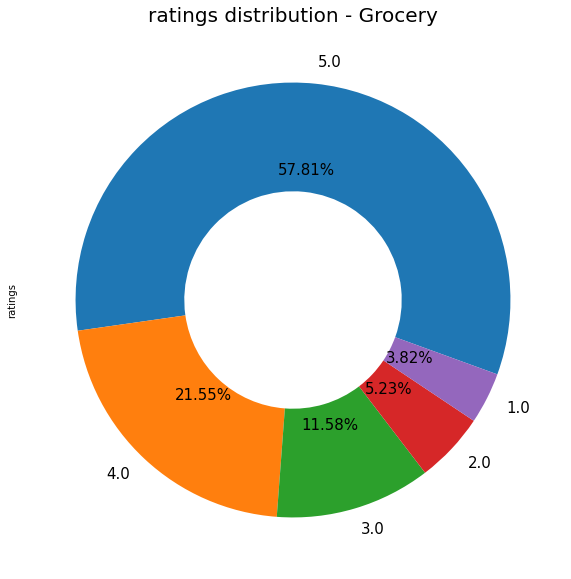

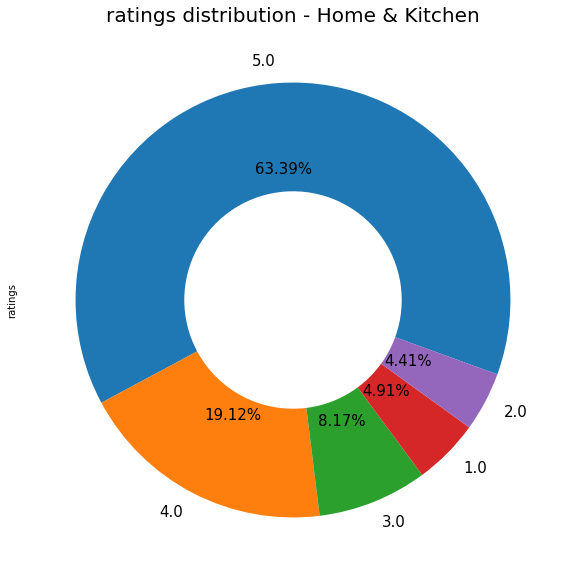

In [30]:
def distribution(df,col,data):
    plt.figure(figsize=(15, 10))
    plt.title(col + " distribution - " + data, fontsize=20)
    a = df[col].value_counts()
    a.plot(kind='pie', labels = a.index,
                              wedgeprops=dict(width=.5), autopct='%1.2f%%', startangle= -20, 
                              textprops={'fontsize': 15})
    
distribution(df_g,'ratings','Grocery')
distribution(df_hk,'ratings','Home & Kitchen')

In [32]:
def helpful(df):
    help_score=[]
    for i in df['helpful']:
        if i[0]==0 and i[1]==0:
            help_score.append(0)
        else:
            helpfulness=i[0]/i[1]
            help_score.append(helpfulness)
    df['helpful_score'] = help_score
    return df

df_g = helpful(df_g)
df_hk = helpful(df_hk)

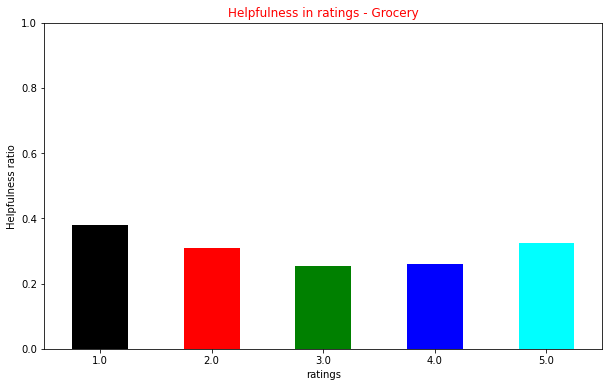

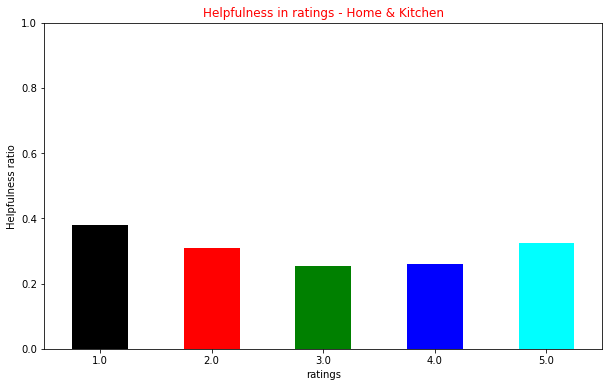

In [33]:
def help_vs_sentiment(df,col,data):
    plt.figure(figsize = (10,6))
    df_g.groupby(col)['helpful_score'].mean().plot(kind='bar', color=['black', 'red', 'green', 'blue', 'cyan']) 
    plt.title("Helpfulness in " + col + " - " + data, color='r')
    plt.xlabel(col)
    plt.ylabel("Helpfulness ratio")
    plt.ylim([0, 1])
    plt.xticks(rotation=0)
    plt.show()

help_vs_sentiment(df_g,'ratings','Grocery')
help_vs_sentiment(df_hk,'ratings' ,'Home & Kitchen')

In [34]:
def year_cal(df):
    df['year'] = df['reviewTime'].dt.year

year_cal(df_g)
year_cal(df_hk)

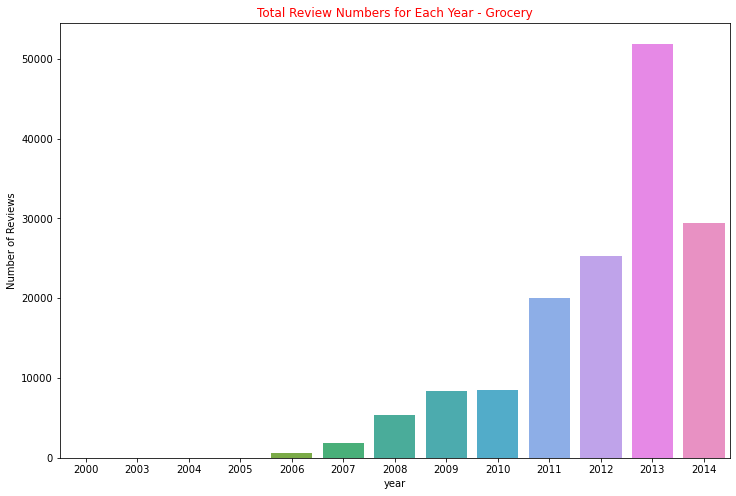

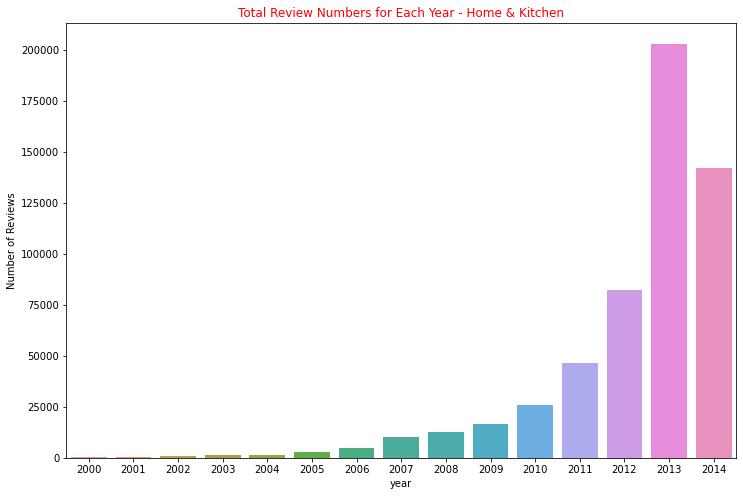

In [35]:
def year_count(df,data): 
    plt.figure(figsize = (12,8))
    sns.countplot(df['year'])
    plt.title('Total Review Numbers for Each Year' + " - " + data, color='r')
    plt.xlabel('year')
    plt.ylabel('Number of Reviews')
    plt.show()

year_count(df_g,'Grocery')
year_count(df_hk,'Home & Kitchen')

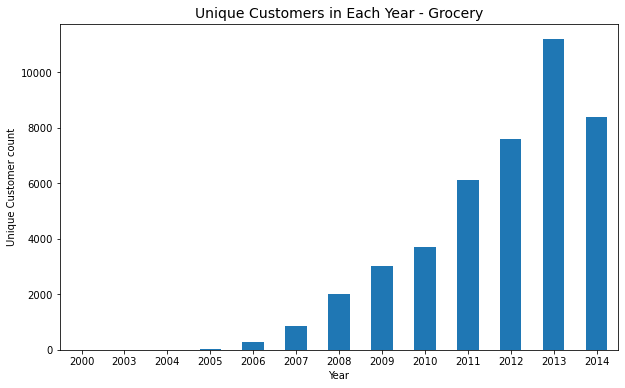

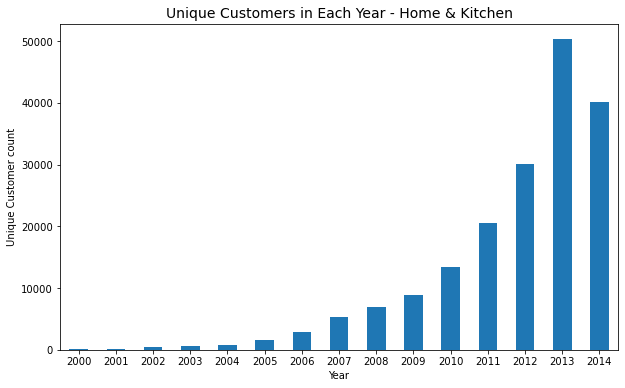

In [36]:
def unique_cust(df,data):
    # How many unique customers in each year?
    unique_cust = df.groupby('year')['reviewerID'].nunique()

    # Plot unique customer numbers in each year
    plt.figure(figsize = (10,6))
    unique_cust.plot(kind='bar', rot = 0)
    plt.title('Unique Customers in Each Year' + " - " + data, size = 14)
    plt.xlabel('Year')
    plt.ylabel('Unique Customer count')
    plt.show()

unique_cust(df_g,'Grocery')
unique_cust(df_hk,'Home & Kitchen')

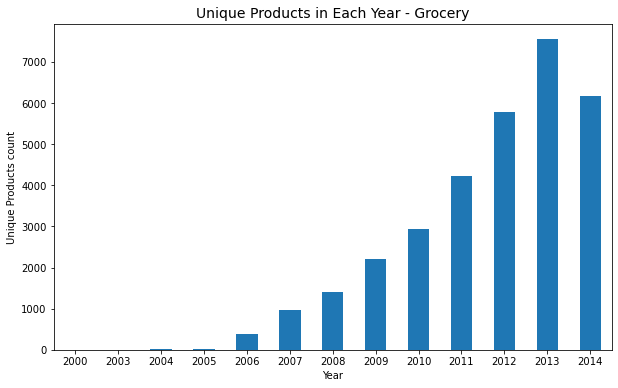

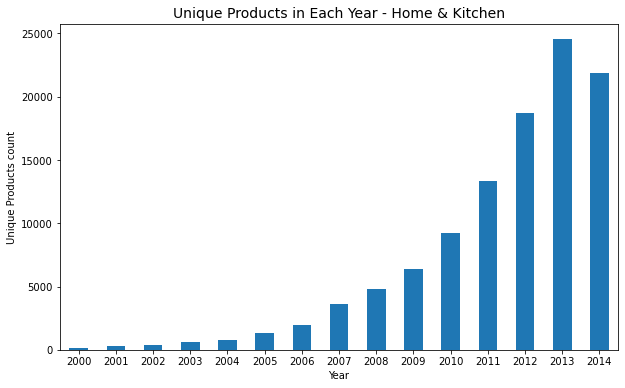

In [37]:
def unique_prod(df,data):
    # How many unique customers in each year?
    unique_cust = df.groupby('year')['asin'].nunique()

    # Plot unique customer numbers in each year
    plt.figure(figsize = (10,6))
    unique_cust.plot(kind='bar', rot = 0)
    plt.title('Unique Products in Each Year' + " - " + data, size = 14)
    plt.xlabel('Year')
    plt.ylabel('Unique Products count')
    plt.show()

unique_prod(df_g,'Grocery')
unique_prod(df_hk,'Home & Kitchen')

In [41]:
def len_count(df):
    df['word_count'] = df['reviewText'].apply(lambda x: len(str(x).split()))
    df['review_len'] = df['reviewText'].astype(str).apply(len)
    return df

df_g = len_count(df_g)
df_hk = len_count(df_hk)

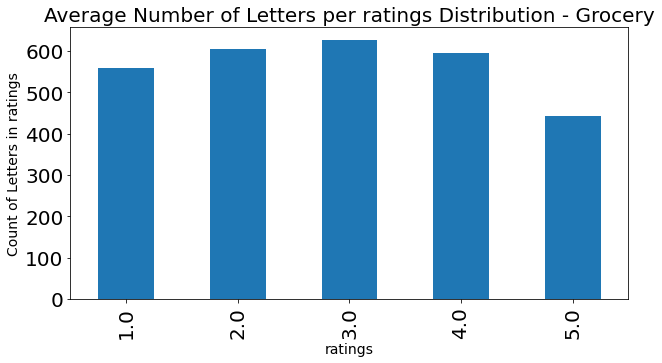

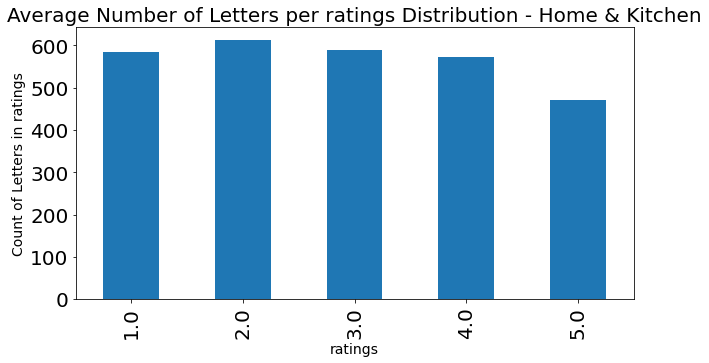

In [58]:
def letter(df,col,data):
    letter_avg = df.groupby(col)['review_len'].mean().plot(kind='bar', figsize=(10,5))
    plt.xlabel(col, fontsize=14)
    plt.ylabel('Count of Letters in ' + col, fontsize=14)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    plt.title('Average Number of Letters per '+ col +' Distribution - ' + data, fontsize=20)
    plt.show()    
    
letter(df_g,'ratings','Grocery')
letter(df_hk,'ratings','Home & Kitchen')

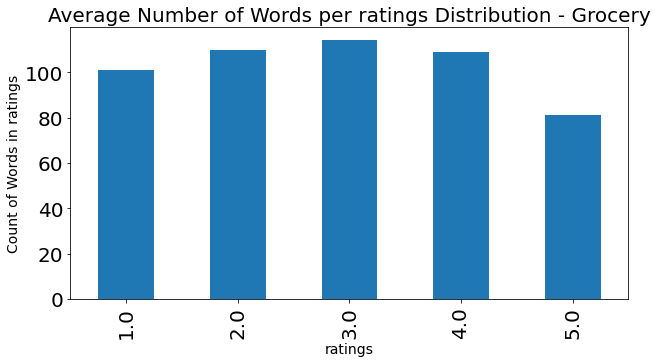

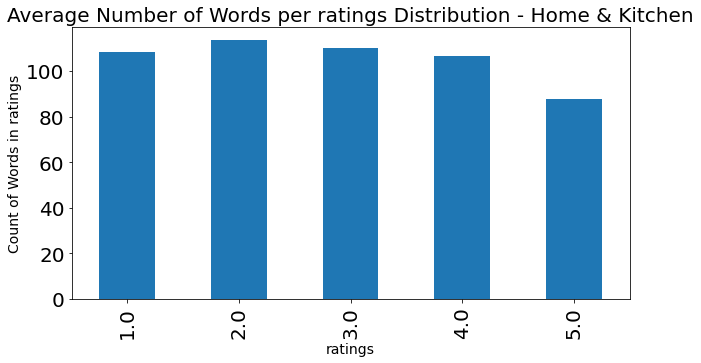

In [59]:
def word(df,col,data):
    word_avg = df.groupby(col)['word_count'].mean().plot(kind='bar', figsize=(10,5))
    plt.xlabel(col, fontsize=14)
    plt.ylabel('Count of Words in ' + col, fontsize=14)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    plt.title('Average Number of Words per '+ col +' Distribution - ' + data, fontsize=20)
    plt.show()
    
word(df_g,'ratings','Grocery')
word(df_hk,'ratings','Home & Kitchen')

In [49]:
def convert(df):
    l = []
    for i in df['reviewText']:
#         li = list(i.split(" "))
        li = [word for word in word_tokenize(i) if word.isalpha()]
        l.append(li)
    df['Lemma_list'] = l
    return df

# convert(df_g)
df_g = convert(df_g)
df_hk = convert(df_hk)

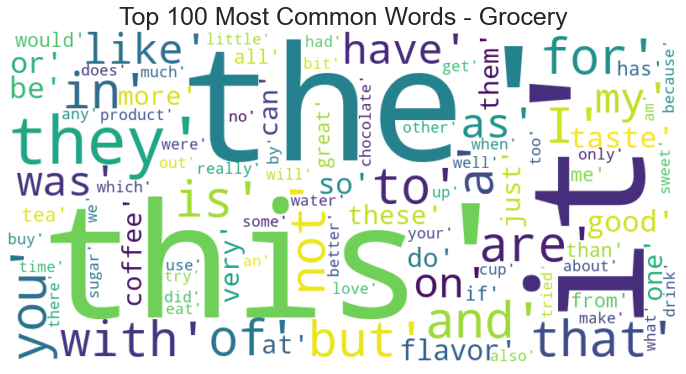

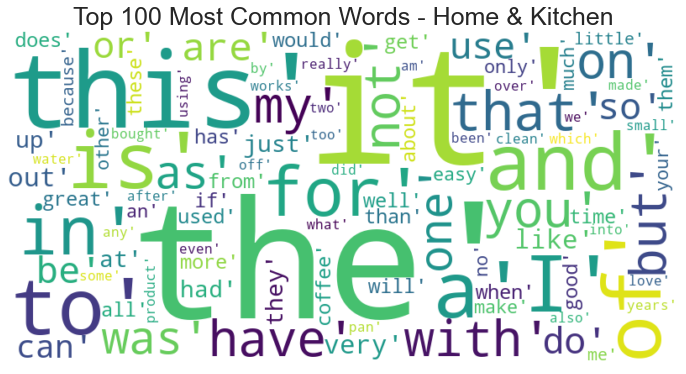

In [98]:
from nltk.probability import FreqDist

def all_words(df):
    allwords = []
    words = df['Lemma_list']
    for wordlist in words:
        allwords += wordlist
    return allwords

def plot_allwords(df,data):
    mostcommon = FreqDist(all_words(df)).most_common(100)
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(str(mostcommon))
    fig = plt.figure(figsize=(10, 5), facecolor='white')
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis('off')
    plt.title('Top 100 Most Common Words - ' + data, fontsize=25)
    plt.tight_layout(pad=0)
    plt.show()

plot_allwords(df_g,'Grocery')
plot_allwords(df_hk,'Home & Kitchen')

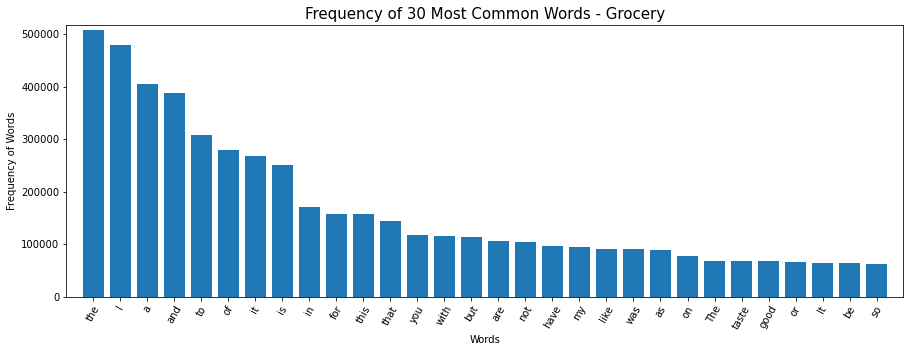

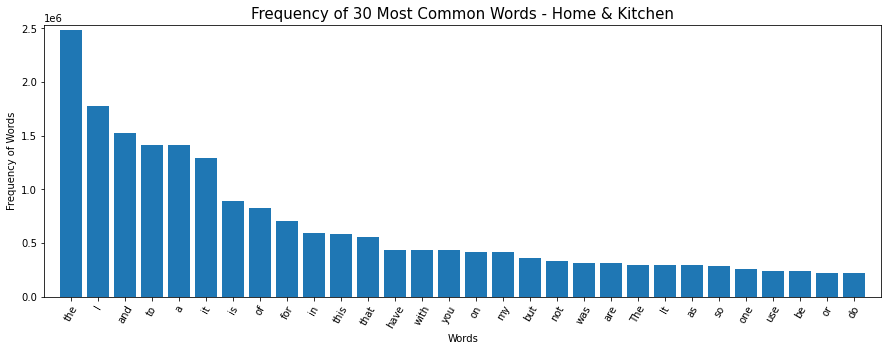

In [51]:
def top_word_freq(df,data):
    mostcommon_small = FreqDist(all_words(df)).most_common(30)
    x, y = zip(*mostcommon_small)
    plt.figure(figsize=(15, 5))
    plt.margins(0.02)
    plt.bar(x, y)
    plt.xlabel('Words', fontsize=10)
    plt.ylabel('Frequency of Words', fontsize=10)
    plt.yticks(fontsize=10)
    plt.xticks(rotation=60, fontsize=10)
    plt.title('Frequency of 30 Most Common Words - ' + data, fontsize=15)
    plt.show()
    
top_word_freq(df_g,'Grocery')
top_word_freq(df_hk,'Home & Kitchen')

# 

# 

# data pre-processing

In [52]:
def dropn_duplicate(df):
    df.drop_duplicates(subset = "reviewText", keep = 'first', inplace = True)
    return df

df_g = dropn_duplicate(df_g)
df_hk = dropn_duplicate(df_hk)

In [53]:
# df_hk = df_hk[:100013]
p = df_hk['asin'].iat[100000]
fd = df_hk[df_hk['asin'] == p]
df_hk = df_hk[:fd.index[-1]]
df_hk.shape

(100082, 14)

In [54]:
# define a function to clean the text
def clean(text):
    # Remove all non-letters and non-spaces except for hyphens and digits
    text = text.encode().decode("utf-8")
    text = re.sub("[^0-9A-Za-z\- ]+", " ", text)
    # Remove all numbers except those attached to a word
    text = re.sub("(?<!\w)\d+", "", text)
    # Remove all hyphens except between two words
    text = re.sub("-(?!\w)|(?<!\w)-", "", text)
    # Remove multiple spaces and lowercase everything
    text = " ".join(text.split())
    # Lowercase everything
    text = text.lower()
    return text

# define a function to remove stopwords and apply tagging
pos_dict = {'J':wordnet.ADJ, 'V':wordnet.VERB, 'N':wordnet.NOUN, 'R':wordnet.ADV}
def token_stop_pos(text):
    words = [word for word in word_tokenize(text) if word.isalpha()]  #
    tags = pos_tag(words)  #
    newlist = []
    for word, tag in tags:
        if word.lower() not in set(stopwords.words('english')):
            newlist.append(tuple([word, pos_dict.get(tag[0])]))
    return newlist

# define a function to lemmatize words
def lemmatize(pos_data):
    wordnet_lemmatizer = WordNetLemmatizer()
    lemma_rew = " "
    for word, pos in pos_data:
        if not pos:
            lemma = word
            lemma_rew = lemma_rew + " " + lemma
        else:
            lemma = wordnet_lemmatizer.lemmatize(word, pos=pos)
            lemma_rew = lemma_rew + " " + lemma
    return lemma_rew

def clean_data(dataframe):
    mydata = dataframe['reviewText']
    mydata = pd.DataFrame(mydata, columns = ['reviewText'])   
    # Cleaning the text in the review column
    mydata['Cleaned_Reviews'] = mydata['reviewText'].apply(clean) 
    # POS tagger dictionary
    mydata['POS_tagged'] = mydata['Cleaned_Reviews'].apply(token_stop_pos)
    # lemmatizing and removing stop words
    mydata['Lemma'] = mydata['POS_tagged'].apply(lemmatize)
    dataframe = pd.concat([dataframe, mydata['Cleaned_Reviews'], mydata['POS_tagged'], mydata['Lemma']], axis = 1)
    return dataframe

df_g = clean_data(df_g)
df_hk = clean_data(df_hk)

In [55]:
# Copying the data into new dataframe called textblob_data
import textblob
from textblob import TextBlob
textblob_g = df_g.copy()
textblob_hk = df_hk.copy()

# Creating additional columns containing polarity score , subjectivity and overall sentiment 
def textblobsentimentanalysis(df):
    sentiment=[]
    subjectivity=[]
    sentiment_score=[]
    for i in df['Cleaned_Reviews'].values:
        review = textblob.TextBlob(i)
    #     print(type(i))
        sentiment_score.append(review.sentiment[0])
        if 0.6 < review.sentiment[0] <= 1.0:
            sentiment.append('Strong Positive')
        elif 0.1 < review.sentiment[0] <= 0.6:
            sentiment.append('Positive')
        elif -0.6 > review.sentiment[0] >= -1.0:
            sentiment.append('Strong Negative')
        elif -0.1 > review.sentiment[0] >= -0.6:
            sentiment.append('Negative')
        else:
            sentiment.append('Neutral')
        subjectivity.append(review.sentiment[1])

    df['Sentiment_Score'] = sentiment_score
    df['Subjectivity'] = subjectivity
    df['Sentiment'] = sentiment
    return df

df_g = textblobsentimentanalysis(df_g)
df_hk = textblobsentimentanalysis(df_hk)

df_g.rename(columns = {'overall':'ratings'}, inplace = True)
df_hk.rename(columns = {'overall':'ratings'}, inplace = True)

In [56]:
labelencoder = LabelEncoder()
df_g['encoded_sentiment'] = labelencoder.fit_transform(df_g['Sentiment'])

trainx, testx, trainy, testy = train_test_split(df_g['Lemma'],
                                                df_g['encoded_sentiment'],
                                                test_size = 0.2,
                                                random_state = 13)
vectorizer = TfidfVectorizer()

trainx_v = vectorizer.fit_transform(trainx)
testx_v = vectorizer.transform(testx)

trainx_v.shape
testx_v.shape

(30240, 60216)


 OneVsRestClassifier(estimator=LogisticRegression(penalty='l1',
                                                 solver='liblinear'))
f1 Score (train): mean = (0.798), min = (0.795), max = (0.803), stdev = (0.002)
f1 Score (test): 0.7982

 OneVsRestClassifier(estimator=LogisticRegression())
f1 Score (train): mean = (0.774), min = (0.772), max = (0.778), stdev = (0.002)
f1 Score (test): 0.7744

 MultinomialNB()
f1 Score (train): mean = (0.663), min = (0.662), max = (0.664), stdev = (0.001)
f1 Score (test): 0.6627

 AdaBoostClassifier()
f1 Score (train): mean = (0.684), min = (0.657), max = (0.691), stdev = (0.009)
f1 Score (test): 0.6872

 XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, gamma=None,
              gpu_id=None, grow_policy=None, importance_type=None,
              interaction_co

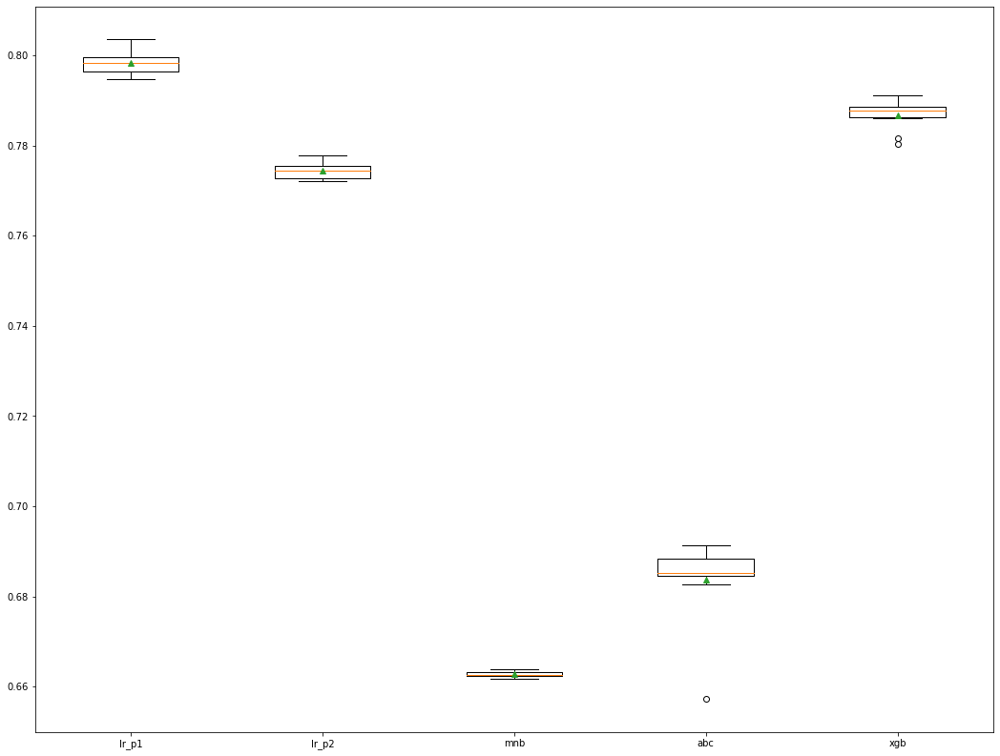

In [62]:
#########################################################################################################################
# model building
lr_p1 = OneVsRestClassifier(LogisticRegression(penalty = 'l1', solver='liblinear'))
lr_p2 = OneVsRestClassifier(LogisticRegression(penalty = 'l2'))
mnb = MultinomialNB()
abc = AdaBoostClassifier()
xgb = XGBClassifier()
l = [lr_p1, lr_p2, mnb, abc, xgb]
names = ['lr_p1','lr_p2','mnb', 'abc', 'xgb']
results, mean_results, p, f1_test = list(), list(), list(), list()

#########################################################################################################################
# model fitting, cross-validating, evaluating performance
def algo(model):
    print('\n', i)
    pipe = Pipeline([('model', model)])
    pipe.fit(trainx_v, trainy)
    cv = StratifiedKFold(n_splits = 10)
    train_n_scores = cross_val_score(pipe, trainx_v, trainy, scoring = 'f1_weighted', cv = cv, n_jobs = -1, error_score = 'raise')
    results.append(train_n_scores)
    mean_results.append(mean(train_n_scores))
    print('f1 Score (train): mean = (%.3f), min = (%.3f), max = (%.3f), stdev = (%.3f)' % (mean(train_n_scores), min(train_n_scores), max(train_n_scores), np.std(train_n_scores)))
    y_pred = cross_val_predict(model, trainx_v, trainy, cv = cv)
    p.append(y_pred)
    f1 = f1_score(trainy, y_pred, average = 'weighted')
    f1_test.append(f1)
    print('f1 Score (test): %.4f' % (f1))
    
for i in l:
    algo(i)
    
#########################################################################################################################
# plot model performance for comparison
fig = plt.subplots(figsize = (18, 14))
plt.boxplot(results, labels = names, showmeans = True)
plt.show()

#########################################################################################################################


 OneVsRestClassifier(estimator=LogisticRegression(penalty='l1',
                                                 solver='liblinear'))
f1 Score (train): mean = (0.848), min = (0.825), max = (0.868), stdev = (0.013)
f1 Score (test): 0.8478

 OneVsRestClassifier(estimator=LogisticRegression())
f1 Score (train): mean = (0.833), min = (0.809), max = (0.849), stdev = (0.011)
f1 Score (test): 0.8336

 MultinomialNB()
f1 Score (train): mean = (0.595), min = (0.592), max = (0.602), stdev = (0.003)
f1 Score (test): 0.5952

 AdaBoostClassifier()
f1 Score (train): mean = (0.587), min = (0.558), max = (0.605), stdev = (0.012)
f1 Score (test): 0.5874

 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
    

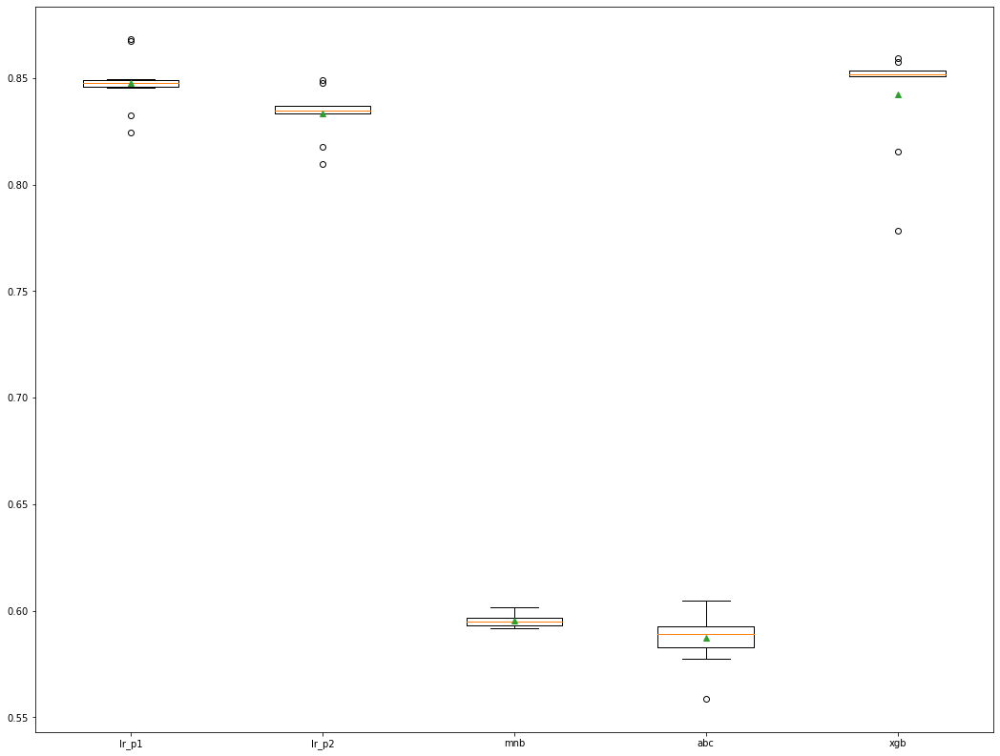

In [63]:
# transform the dataset
# 2:1,15,432  1:25477 0:3907 3:105 4:6278
strategy = {0:30139, 1:25477, 2:115432, 3:36291, 4:24091}
oversample = SMOTE(sampling_strategy=strategy)
x, y = oversample.fit_resample(trainx_v, trainy)
#########################################################################################################################
# model building

results_o, mean_results_o, p_o, f1_test_o = list(), list(), list(), list()

#########################################################################################################################
# model fitting, cross-validating, evaluating performance
def algo(model):
    print('\n', i)
    pipe = Pipeline([('model', model)])
    pipe.fit(trainx_v, trainy)
    cv = StratifiedKFold(n_splits = 10)
    train_n_scores = cross_val_score(pipe, x, y, scoring = 'f1_weighted', cv = cv, n_jobs = -1, error_score = 'raise')
    results_o.append(train_n_scores)
    mean_results_o.append(mean(train_n_scores))
    print('f1 Score (train): mean = (%.3f), min = (%.3f), max = (%.3f), stdev = (%.3f)' % (mean(train_n_scores), min(train_n_scores), max(train_n_scores), np.std(train_n_scores)))
    y_pred = cross_val_predict(model, x, y, cv = cv)
    p_o.append(y_pred)
    f1 = f1_score(y, y_pred, average = 'weighted')
    f1_test_o.append(f1)
    print('f1 Score (test): %.4f' % (f1))
    
for i in l:
    algo(i)
    
#########################################################################################################################
# plot model performance for comparison
fig = plt.subplots(figsize = (18, 14))
plt.boxplot(results_o, labels = names, showmeans = True)
plt.show()

#########################################################################################################################

In [161]:
def evaluatemodel(testy, pred, name):
    print('\n\n',name)
    
    a = accuracy_score(testy, pred)
    print('Model accuracy = {}'.format(a))
    
    f = f1_score(testy, pred, average = 'weighted')
    print('\nModel f1 score = {}'.format(f))
    
    pd.crosstab(testy, pred, margins = True)
    print('\n',classification_report(testy,pred))

In [170]:
lr_l1 = LogisticRegression(penalty = 'l1', solver='liblinear')
lr_ovr_l1 = OneVsRestClassifier(lr_l1).fit(x,y)
a = lr_ovr_l1.score(x, y)
print('Model accuracy (train) = {}'.format(a))
p_l1 = lr_ovr_l1.predict(testx_v)

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_l1}).reset_index(drop = True)

evaluatemodel(testy,p_l1,'Logistic regression-l1 penalty')

Model accuracy (train) = 0.886570453268807


 Logistic regression-l1 penalty
Model accuracy = 0.8055224867724867

Model f1 score = 0.7743047086935105

               precision    recall  f1-score   support

           0       0.33      0.66      0.44       755
           1       0.70      0.19      0.30      5156
           2       0.85      0.96      0.90     23079
           3       0.04      0.04      0.04        24
           4       0.59      0.67      0.63      1226

    accuracy                           0.81     30240
   macro avg       0.50      0.50      0.46     30240
weighted avg       0.80      0.81      0.77     30240



In [171]:
lr_l2 = LogisticRegression(penalty = 'l2')
lr_ovr_l2 = OneVsRestClassifier(lr_l2).fit(x,y)
a = lr_ovr_l2.score(x, y)
print('Model accuracy (train) = {}'.format(a))
p_l2 = lr_ovr_l2.predict(testx_v)

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_l2}).reset_index(drop = True)

evaluatemodel(testy,p_l2,'Logistic regression-l2 penalty')

Model accuracy (train) = 0.8797217301127771


 Logistic regression-l2 penalty
Model accuracy = 0.7952380952380952

Model f1 score = 0.759203376214549

               precision    recall  f1-score   support

           0       0.32      0.65      0.43       755
           1       0.69      0.15      0.25      5156
           2       0.84      0.96      0.89     23079
           3       0.03      0.04      0.04        24
           4       0.54      0.56      0.55      1226

    accuracy                           0.80     30240
   macro avg       0.48      0.47      0.43     30240
weighted avg       0.79      0.80      0.76     30240



In [173]:
lr_l2 = LogisticRegression(C=5, penalty = 'l2')
lr_ovr_l2 = OneVsRestClassifier(lr_l2).fit(x,y)
a = lr_ovr_l2.score(x, y)
print('Model accuracy (train) = {}'.format(a))
p_l2 = lr_ovr_l2.predict(testx_v)

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_l2}).reset_index(drop = True)

evaluatemodel(testy,p_l2,'Logistic regression-l2 penalty')

Model accuracy (train) = 0.9079332843624422


 Logistic regression-l2 penalty
Model accuracy = 0.8017857142857143

Model f1 score = 0.7772182944385112

               precision    recall  f1-score   support

           0       0.33      0.59      0.42       755
           1       0.64      0.24      0.35      5156
           2       0.85      0.95      0.90     23079
           3       0.00      0.00      0.00        24
           4       0.56      0.61      0.58      1226

    accuracy                           0.80     30240
   macro avg       0.48      0.48      0.45     30240
weighted avg       0.79      0.80      0.78     30240



In [169]:
from sklearn.linear_model import LogisticRegressionCV

# lr_l2 = LogisticRegression(C=0.5, penalty = 'l2')
lr_ovr_l2_cv = LogisticRegressionCV(multi_class = 'ovr', penalty = 'l2').fit(x,y)
a = lr_ovr_l2_cv.score(x, y)
print('Model accuracy (train) = {}'.format(a))
p_l2_cv = lr_ovr_l2_cv.predict(testx_v)

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_l2_cv}).reset_index(drop = True)

evaluatemodel(testy,p_l2_cv,'Logistic regression-l2 penalty')

Model accuracy (train) = 0.947651557706434


 Logistic regression-l2 penalty
Model accuracy = 0.7868386243386244

Model f1 score = 0.770767622343383

               precision    recall  f1-score   support

           0       0.30      0.41      0.35       755
           1       0.52      0.30      0.38      5156
           2       0.85      0.92      0.88     23079
           3       0.14      0.04      0.06        24
           4       0.55      0.60      0.58      1226

    accuracy                           0.79     30240
   macro avg       0.47      0.45      0.45     30240
weighted avg       0.77      0.79      0.77     30240



In [175]:
from sklearn.linear_model import LogisticRegressionCV

# lr_l2 = LogisticRegression(C=0.5, penalty = 'l2')
lr_ovr_l1_cv = LogisticRegressionCV(multi_class = 'ovr', penalty = 'l1', solver='liblinear').fit(x,y)
a = lr_ovr_l1_cv.score(x, y)
print('Model accuracy (train) = {}'.format(a))
p_l1_cv = lr_ovr_l1_cv.predict(testx_v)

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_l1_cv}).reset_index(drop = True)

evaluatemodel(testy,p_l1_cv,'Logistic regression-l1 penalty')

Model accuracy (train) = 0.9533941148511429


 Logistic regression-l1 penalty
Model accuracy = 0.7808862433862434

Model f1 score = 0.7683748156593205

               precision    recall  f1-score   support

           0       0.32      0.43      0.37       755
           1       0.49      0.32      0.39      5156
           2       0.85      0.91      0.88     23079
           3       0.00      0.00      0.00        24
           4       0.55      0.61      0.58      1226

    accuracy                           0.78     30240
   macro avg       0.44      0.45      0.44     30240
weighted avg       0.76      0.78      0.77     30240



In [158]:
xgb = XGBClassifier().fit(x,y)
p_xg = xgb.predict(testx_v)
a = lr_ovr.score(x, y)
print('Model accuracy (train) = {}'.format(a))

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_xg}).reset_index(drop = True)
evaluatemodel(testy,p_xg,'xgboost classifier')

Model accuracy (train) = 0.8865747742297887


 xgboost classifier
Model accuracy = 0.8046626984126984

Model f1 score = 0.7795979188289881

               precision    recall  f1-score   support

           0       0.37      0.53      0.43       755
           1       0.70      0.26      0.38      5156
           2       0.85      0.95      0.90     23079
           3       0.03      0.08      0.05        24
           4       0.52      0.52      0.52      1226

    accuracy                           0.80     30240
   macro avg       0.49      0.47      0.45     30240
weighted avg       0.80      0.80      0.78     30240



In [183]:
xgb = XGBClassifier(learning_rate = 1).fit(x,y)
p_xg = xgb.predict(testx_v)
a = lr_ovr.score(x, y)
print('Model accuracy (train) = {}'.format(a))

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_xg}).reset_index(drop = True)
evaluatemodel(testy,p_xg,'xgboost classifier - lr(1)')

Model accuracy (train) = 0.8865747742297887


 xgboost classifier - lr(1)
Model accuracy = 0.829728835978836

Model f1 score = 0.8209200862285729

               precision    recall  f1-score   support

           0       0.44      0.48      0.46       755
           1       0.67      0.47      0.55      5156
           2       0.88      0.94      0.91     23079
           3       0.09      0.04      0.06        24
           4       0.58      0.57      0.57      1226

    accuracy                           0.83     30240
   macro avg       0.53      0.50      0.51     30240
weighted avg       0.82      0.83      0.82     30240



In [181]:
xgb = XGBClassifier(learning_rate = 5).fit(x,y)
p_xg = xgb.predict(testx_v)
a = lr_ovr.score(x, y)
print('Model accuracy (train) = {}'.format(a))

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_xg}).reset_index(drop = True)
evaluatemodel(testy,p_xg,'xgboost classifier - lr(5)')

Model accuracy (train) = 0.8865747742297887


 xgboost classifier - lr(5)
Model accuracy = 0.751521164021164

Model f1 score = 0.6680882237808935

               precision    recall  f1-score   support

           0       0.10      0.07      0.09       755
           1       0.56      0.01      0.02      5156
           2       0.77      0.98      0.86     23079
           3       0.02      0.12      0.03        24
           4       0.24      0.06      0.10      1226

    accuracy                           0.75     30240
   macro avg       0.34      0.25      0.22     30240
weighted avg       0.70      0.75      0.67     30240



In [182]:
xgb = XGBClassifier(learning_rate = 10).fit(x,y)
p_xg = xgb.predict(testx_v)
a = lr_ovr.score(x, y)
print('Model accuracy (train) = {}'.format(a))

results = pd.DataFrame({
                'actual' : testy,
                'predicted' : p_xg}).reset_index(drop = True)
evaluatemodel(testy,p_xg,'xgboost classifier - lr(10)')

Model accuracy (train) = 0.8865747742297887


 xgboost classifier - lr(10)
Model accuracy = 0.7245039682539682

Model f1 score = 0.652798799634037

               precision    recall  f1-score   support

           0       0.00      0.00      0.00       755
           1       0.00      0.00      0.00      5156
           2       0.78      0.95      0.86     23079
           3       0.00      0.17      0.00        24
           4       0.00      0.00      0.00      1226

    accuracy                           0.72     30240
   macro avg       0.16      0.22      0.17     30240
weighted avg       0.59      0.72      0.65     30240



In [188]:
testy

11830     4
43469     2
110042    2
86116     2
12622     1
         ..
67354     2
78308     1
17459     2
79103     2
136905    1
Name: encoded_sentiment, Length: 30240, dtype: int32

In [190]:
# xgb = XGBClassifier(learning_rate = 1).fit(x,y)
# n_classes = len(set(y))
# y_score = xgb.predict_proba(testx_v)
# precision = dict()
# recall = dict()
# for i in range(n_classes):
#     precision[i], recall[i], _ = precision_recall_curve(testy[:, i],
#                                                         y_score[:, i])
#     plt.plot(recall[i], precision[i], lw=2, label='class {}'.format(i))
    
# plt.xlabel("recall")
# plt.ylabel("precision")
# plt.legend(loc="best")
# plt.title("precision vs. recall curve")
# plt.show()

In [147]:
unknown=['I had never had it before, was curious to see what it was like. Smooth, great subtle good flavor. I am ordering more and plan to make it a routine.',
        "i used to buy these all the time, but I moved and could no longer find them at the grocery. I was excited to see them on amazon warehouse deals, but they arrived very stale. Maybe I just don't get warehouse deals and it was supposed to taste horrible? That seems wrong. Also somewhat different flavor and packaging than I remember years ago at the grocery.",
        "I bought this on impulse and it comes from Japan,  which amused my family,  all those weird stamps and markings on the package. So that was fun.  It said it would take about a month to arrive and it did take that long.  I was hoping for a more interesting taste but to our family,  it just tasted a bit less flavorful or weaker than the standard milk chocolate kit kat.  The green tea flavor was too subtle for the sugar and it just tasted sweet. The wafers were very crispy, and that was good,  but it tasted a bit anemic to us.I'm happy I bought it, but don't need to buy it again",
        "This cheese made it to Afghanistan! I love cheese and being deployed that's one of the things I missed. I gave it a shot and order it and it arrived to me in perfect condition. Well packed and vaccumed sealed. Great taste!!!",
        "I drink all types of teas, but this is one of the worst tasting teas, in my opinion."]

vectorizer = TfidfVectorizer(max_features = 60216)
trainx_v_f = vectorizer.fit_transform(trainx)
predict_la = vectorizer.transform(unknown)
lr_p1 = OneVsRestClassifier(LogisticRegression(penalty = 'l1', solver='liblinear')).fit(trainx_v, trainy)
pred_lr = lr_p1.predict(predict_la)

In [148]:
pred_lr

array([2, 0, 2, 2, 1])

In [189]:
xgb = XGBClassifier(learning_rate = 1).fit(x,y)
pred_xg = xgb.predict(predict_la)
pred_xg

array([2, 0, 2, 4, 1], dtype=int64)

In [68]:
df_g.to_csv('capstone_grocery_final_code.csv')
df_hk.to_csv('capstone_home_final_code.csv')

In [73]:
df_g.rename(columns = {'t_Sentiment Score':'Sentiment_Score','t_Subjectivity':'Subjectivity','t_Overall_Sentiment':'Sentiment'}, inplace = True)
df_hk.rename(columns = {'t_Sentiment Score':'Sentiment_Score','t_Subjectivity':'Subjectivity','t_Overall_Sentiment':'Sentiment'}, inplace = True)

In [74]:
df_g_n = df_g[(df_g['Sentiment'] == 'Negative') | (df_g['Sentiment'] == 'Strong Negative')]
df_hk_n = df_hk[(df_hk['Sentiment'] == 'Negative') | df_hk['Sentiment'] == 'Strong Negative']

In [75]:
products_g = df_g_n['asin'].value_counts().head(5).index
products_hk = df_hk_n['asin'].value_counts().head(5).index

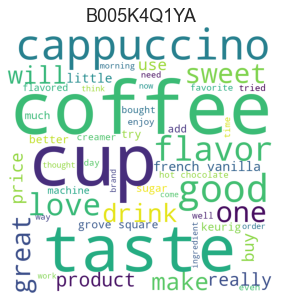

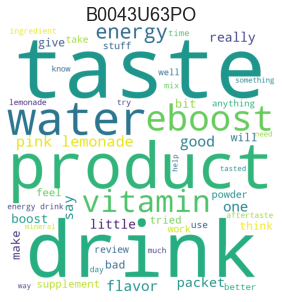

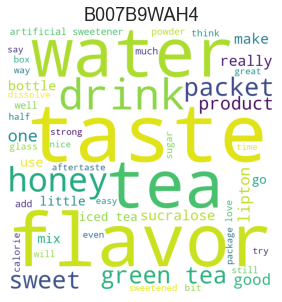

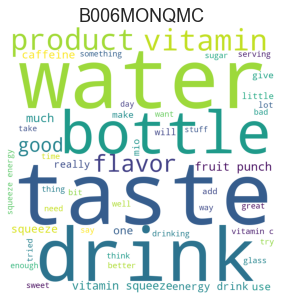

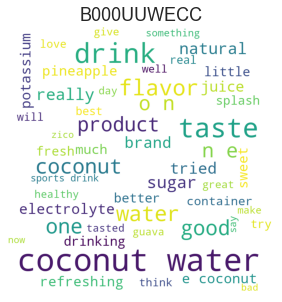

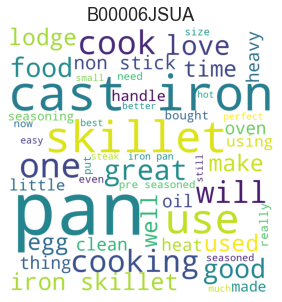

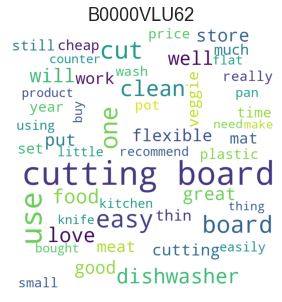

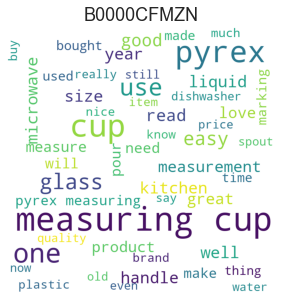

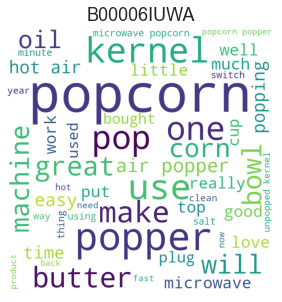

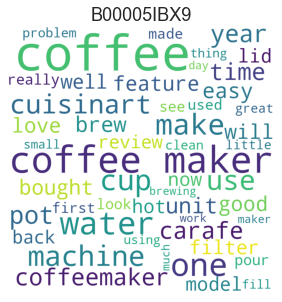

In [138]:
products_g = ['B005K4Q1YA', 'B0043U63PO', 'B007B9WAH4', 'B006MONQMC', 'B000UUWECC']
products_hk = ['B00006JSUA', 'B0000VLU62', 'B0000CFMZN', 'B00006IUWA', 'B00005IBX9']

def wc(df, pid, max_word):
    fd = df[df['asin'] == pid]
    comment_words = ''
    stopwords = set(STOPWORDS)
    for val in fd.reviewText:
        # split the value
        tokens = val.split()
     
        # Converts each token into lowercase
#         for i in range(len(tokens)):
#             tokens[i] = tokens[i].lower()
     
        comment_words += " ".join(tokens)+" "

    wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                max_words = max_word,
                min_font_size = 10).generate(comment_words)

    # plot the WordCloud image                      
    plt.figure(figsize = (4, 4), facecolor = None)
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(pid)
    plt.tight_layout(pad = 0)
    plt.show()

for pid in products_g:
    wc(df_g, pid, 50)

for pid in products_hk:
    wc(df_hk, pid, 50)

In [177]:
def Top_5Product(df,pid):
    vectorizer = TfidfVectorizer(
                    sublinear_tf=True,      
                    max_df=0.7,
                    min_df=1, 
                    stop_words=stopwords.words('english'),
                    use_idf=True, 
                    smooth_idf=True,
                ngram_range=(3,3))
    trainx_v = vectorizer.fit_transform(df[df['asin'] == pid]['reviewText'])
    trainy = df[df['asin'] == pid]['Sentiment']
    m1 = LogisticRegression().fit(trainx_v,trainy)
    dct_words = {}

    keys = vectorizer.vocabulary_.keys()

    for k in keys:
        kval = vectorizer.vocabulary_.get(k)
        dct_words[kval] = k
  
    idx = (m1.coef_[0]).argsort()
    
    print("\n\nnegative word list....")

    for x in idx:
        print(dct_words[x])
    print("-------------------------------------")
    
for pid in products_g:
    Top_5Product(df_g, pid)

for pid in products_hk:
    Top_5Product(df_hk, pid)



negative word list....
cherry cashew bar
organic cherry cashew
organic wild blueberry
pure bar organic
wild blueberry bar
rice protein concentrate
bar organic cherry
cashew raw fruit
cherry cashew raw
bar organic wild
fruit nut bars
blueberry raw fruit
wild blueberry raw
organic rice protein
organic gluten free
pure organic wild
bar 190 calories
full serving fruit
cashews walnuts almonds
190 calories 70
ounce bars pack
cherry cashew flavor
natural fruit sugars
organic agave nectar
organic cashews organic
organic dates organic
nothing cooked nothing
vegan gluten free
produced facility processes
lemon juice concentrate
bars pack 12
like fig newton
apple juice concentrate
organic walnuts organic
calories 70 fat
agave nectar almonds
cooked nothing processed
pure organic cherry
processes soy milk
bar ounce bars
nut bar ounce
amazon vine program
fructose corn syrup
high fructose corn
dates organic cashews
gluten free vegan
best ever tasted
protein concentrate organic
peanuts fish tree
fish

# 

# 

### sentiment analysis

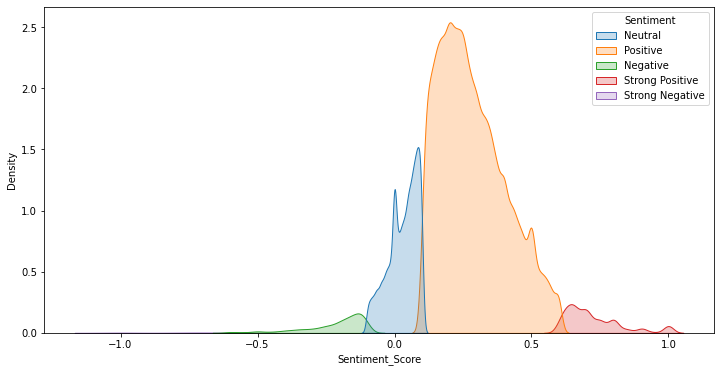

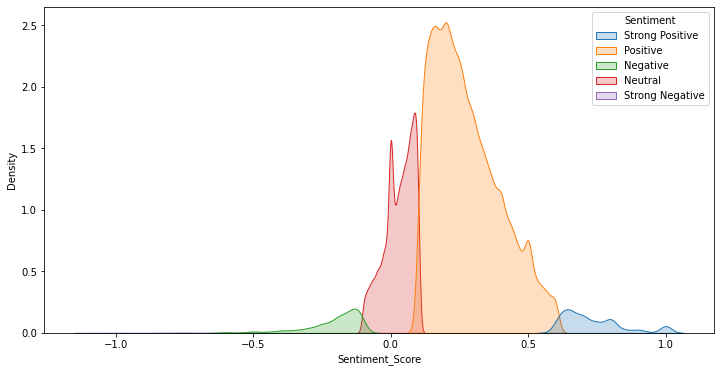

In [79]:
def kde_plot(df):
    plt.subplots(figsize=(12,6))
    sns.kdeplot(df['Sentiment_Score'], hue = df['Sentiment'], fill = True)

kde_plot(df_g)
kde_plot(df_hk)

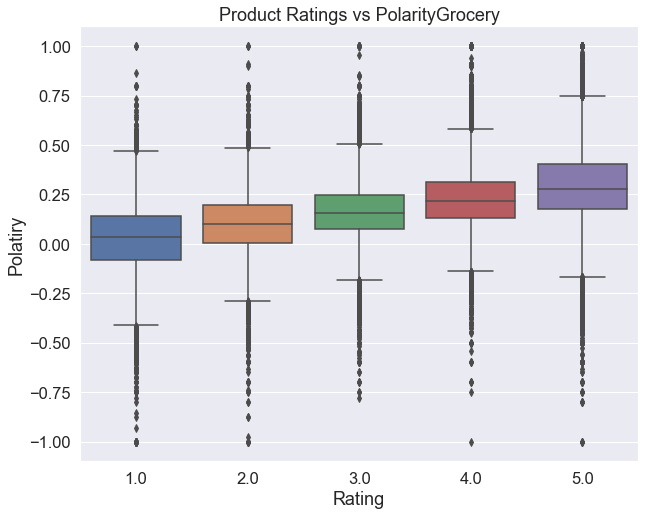

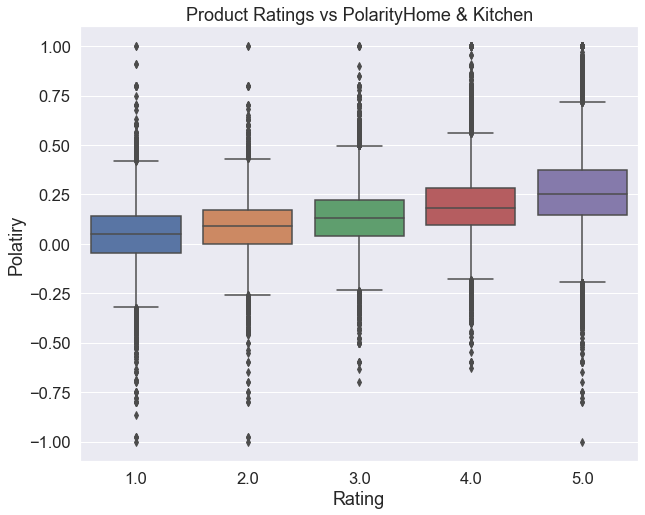

In [80]:
def rate_vs_polarity(df,data):
    plt.figure(figsize = (10, 8))
    sns.set_style('whitegrid')
    sns.set(font_scale = 1.5)
    sns.boxplot(x = 'ratings', y = 'Sentiment_Score', data = df)
    plt.xlabel("Rating")
    plt.ylabel("Polatiry")
    plt.title("Product Ratings vs Polarity" + data)
    plt.show()
    
rate_vs_polarity(df_g,'Grocery')
rate_vs_polarity(df_hk,'Home & Kitchen')

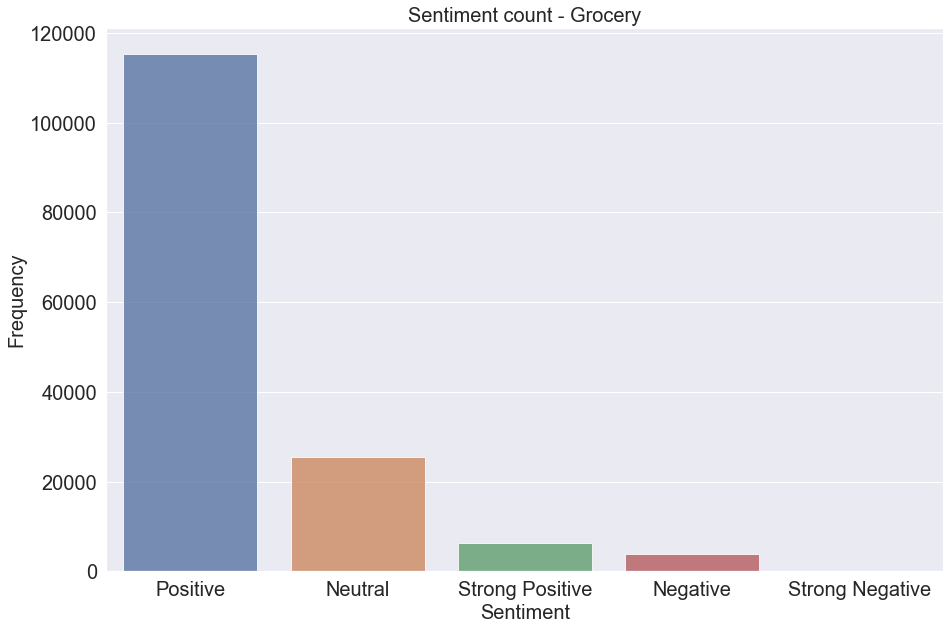

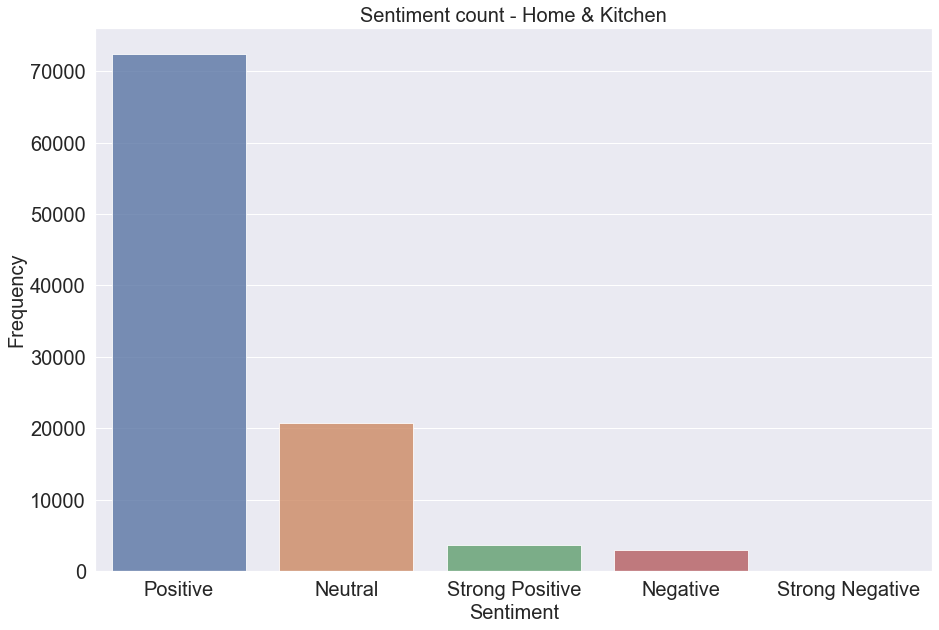

In [83]:
count(df_g,'Sentiment','Grocery')
count(df_hk,'Sentiment','Home & Kitchen')

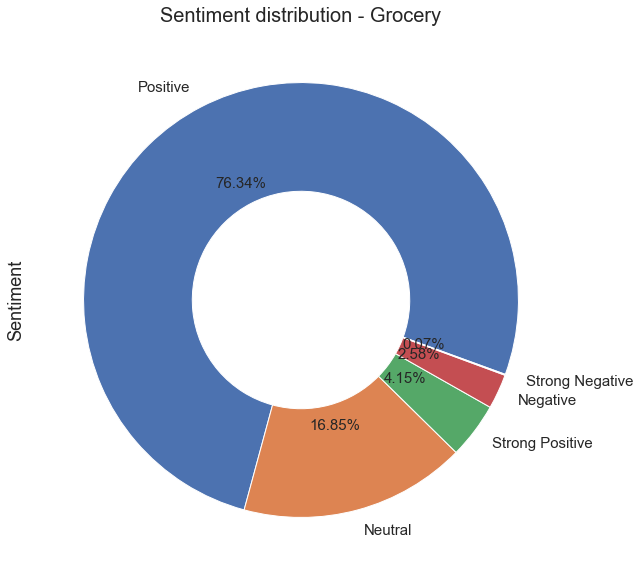

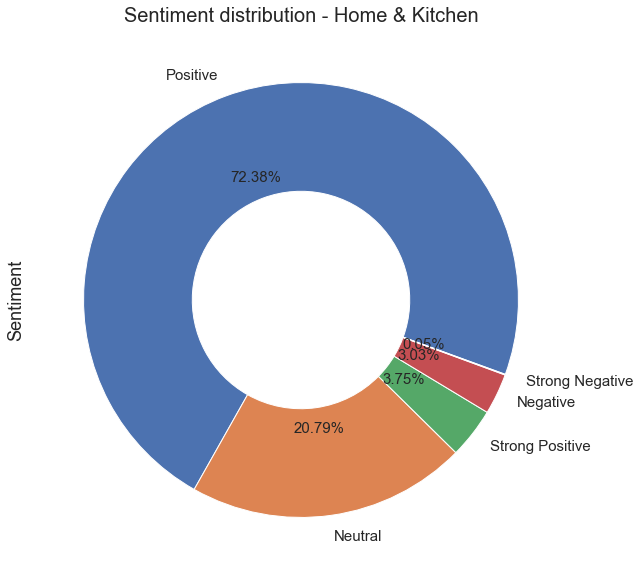

In [84]:
distribution(df_g,'Sentiment','Grocery')
distribution(df_hk,'Sentiment','Home & Kitchen')

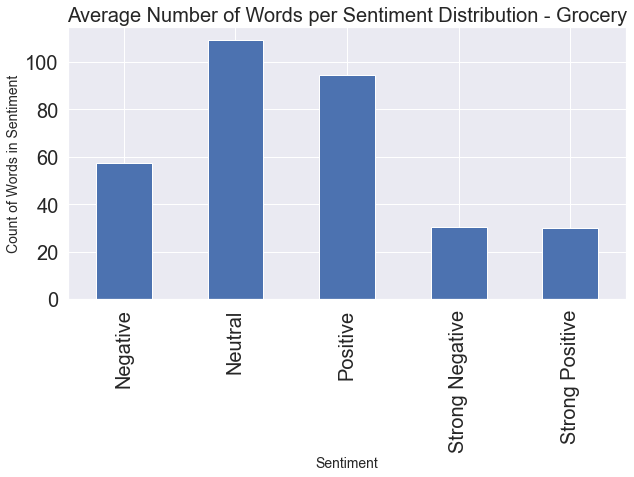

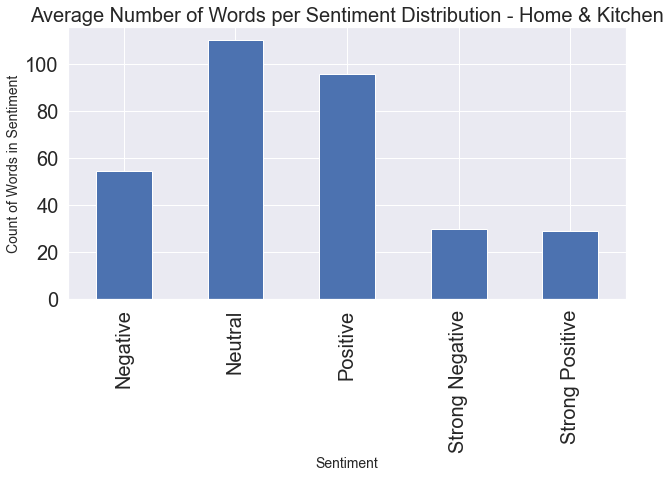

In [85]:
word(df_g,'Sentiment','Grocery')
word(df_hk,'Sentiment','Home & Kitchen')

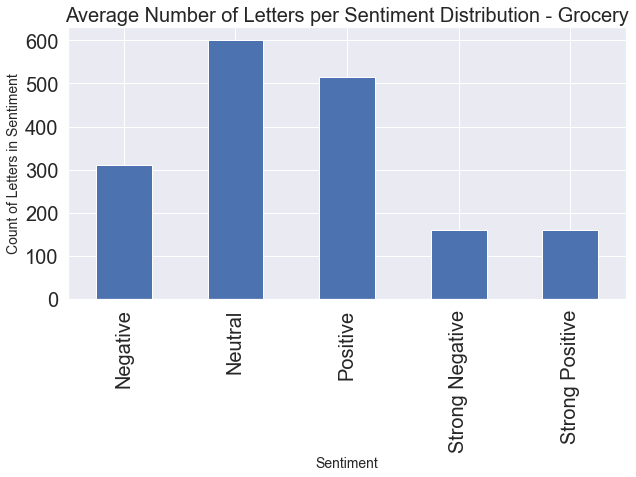

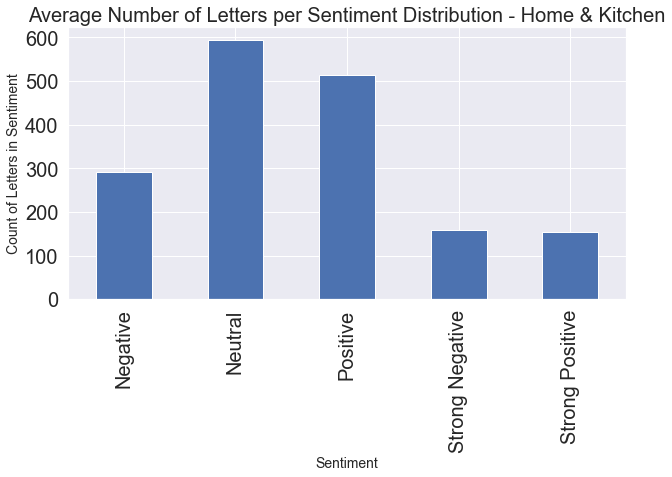

In [86]:
letter(df_g,'Sentiment','Grocery')
letter(df_hk,'Sentiment','Home & Kitchen')

In [ ]:
df1=df_g.sort_values(by=['reviewerID','reviewTime'])
purchase1=df1.groupby('reviewerID')['reviewTime'].min()
purchase1=pd.DataFrame(purchase1)
purchase1.reset_index(inplace=True)
purchase2=df1.groupby('reviewerID')['reviewTime'].max()
purchase2=pd.DataFrame(purchase2)
purchase2.reset_index(inplace=True)
frequency=df1.groupby('reviewerID')['reviewerID'].count()
frequency=pd.DataFrame(frequency)
frequency.rename(columns={'reviewerID':'Count'},inplace=True)
frequency.reset_index(inplace=True)
from functools import reduce
new_df1=reduce(lambda x,y: pd.merge(x,y,on=['reviewerID']),[purchase1,purchase2,frequency])
new_df1['Difference']=(new_df1['reviewTime_y']-new_df1['reviewTime_x'])
new_df1['Difference'].value_counts()
multiple_shop=new_df1[new_df1['Difference']!='0 days']

In [184]:
multiple_shop

,reviewerID,reviewTime_x,reviewTime_y,Count,Difference
1,A0010876CNE3ILIM9HV0,2013-12-05,2014-02-03,2,60 days
9,A03756272FRRX98COZNG7,2013-08-30,2013-12-31,2,123 days
10,A04740333HUOPRGNFV2HM,2014-04-23,2014-07-08,2,76 days
24,A100L918633LUO,2013-09-25,2014-02-26,7,154 days
26,A100WO06OQR8BQ,2008-04-04,2014-03-05,2,2161 days
...,...,...,...,...,...
44888,AZZCQ9NJ4OZ1U,2013-05-07,2013-11-14,2,191 days
44890,AZZJ5QK1QL75B,2007-11-08,2009-01-06,2,425 days
44891,AZZNK89PXD006,2010-03-27,2010-08-10,3,136 days
44892,AZZP6TVC3ISPY,2013-12-05,2014-01-25,2,51 days


In [ ]:
multiple_shop['Shopping_freq']=multiple_shop['Difference']/multiple_shop['Count']
multiple_shop['Shopping_freq'].mean()

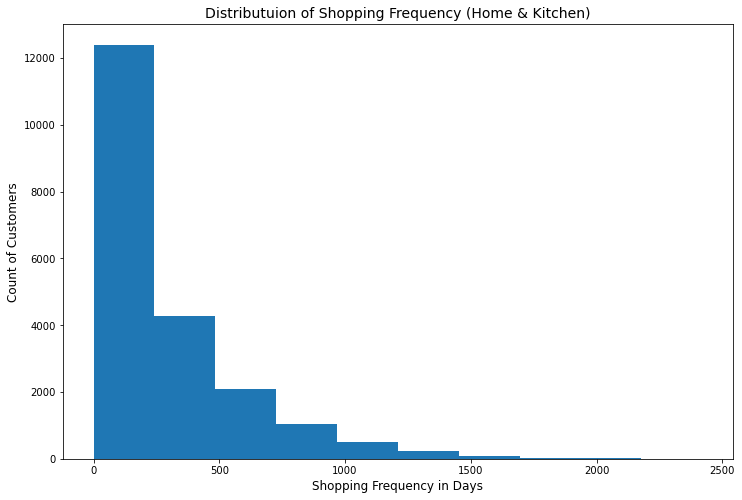

In [188]:
_,ax=plt.subplots(1,1,figsize=(12,8))
plt.hist(multiple_shop['Shopping_freq'].apply(lambda x:x.days))
plt.ylabel('Count of Customers',fontsize=12)
plt.xlabel('Shopping Frequency in Days',fontsize=12)
plt.title('Distributuion of Shopping Frequency (Home & Kitchen)',fontsize=14)
plt.show()

In [ ]:
multiple_shop['frequency_days']=multiple_shop['Shopping_freq'].apply(lambda x:x.days)
multiple_shop.to_csv('HK_Frequncy.csv')
analysis_11=multiple_shop.copy()
analysis=multiple_shop['frequency_days']>280
analysis_11.loc[analysis_11['frequency_days']>280,'frequency_days']=280

In [194]:
analysis_11['frequency_days'].mean()

165.6494875265906

In [195]:
#Count of Target Customers(Home and Kitchen): 7359
#Total Customers(Home and Kitchen):20684

#35.57% of the customers shopping from Home and Kitchen category have a shooping frequency greater than the average shopping 
#frequency of 280 days.

# To further reduce the overall shopping frequency , we should target these customers and if we manage to reduce this number to 
# 280 days then the overall shopping frequency would reduce to 166 days.

In [ ]:
df1=df_hk.sort_values(by=['reviewerID','reviewTime'])
purchase1=df1.groupby('reviewerID')['reviewTime'].min()
purchase1=pd.DataFrame(purchase1)
purchase1.reset_index(inplace=True)
purchase2=df1.groupby('reviewerID')['reviewTime'].max()
purchase2=pd.DataFrame(purchase2)
purchase2.reset_index(inplace=True)
frequency=df1.groupby('reviewerID')['reviewerID'].count()
frequency=pd.DataFrame(frequency)
frequency.rename(columns={'reviewerID':'Count'},inplace=True)
frequency.reset_index(inplace=True)
from functools import reduce
new_df1=reduce(lambda x,y: pd.merge(x,y,on=['reviewerID']),[purchase1,purchase2,frequency])
new_df1['Difference']=(new_df1['reviewTime_y']-new_df1['reviewTime_x'])
new_df1['Difference'].value_counts()
multiple_shop=new_df1[new_df1['Difference']!='0 days']
multiple_shop['Shopping_freq']=multiple_shop['Difference']/multiple_shop['Count']
multiple_shop['Shopping_freq'].mean()

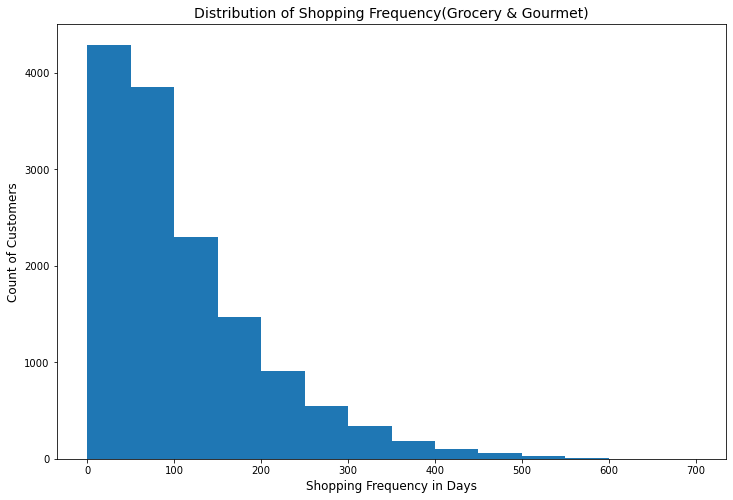

In [211]:
_,ax=plt.subplots(1,1,figsize=(12,8))
plt.hist(multiple_shop['Shopping_freq'].apply(lambda x:x.days),bins=[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700])
plt.ylabel('Count of Customers',fontsize=12)
plt.xlabel('Shopping Frequency in Days',fontsize=12)
plt.title('Distribution of Shopping Frequency(Grocery & Gourmet)',fontsize=14)
plt.show()

In [ ]:
multiple_shop['frequency_days']=multiple_shop['Shopping_freq'].apply(lambda x:x.days)
multiple_shop.to_csv('GG_frequency.csv')
analysis=multiple_shop['frequency_days']>110
analysis_1=multiple_shop.copy()
analysis_1.loc[analysis_1['frequency_days']>110,'frequency_days']=100

In [89]:
analysis_1['frequency_days'].mean()

69.97731300957108

In [ ]:
#Count of Target Customers(Grocery and Gourmet): 5352
#Total Customers(Grocery and Gourmet):14105

#37.9% of the customers shopping from Grocery and Gourmet category have a shooping frequency greater than the average shopping 
#frequency of 110 days.

# To further reduce the overall shopping frequency , we should target these customers and if we manage to reduce this number to 
# 100 days then the overall shopping frequency would reduce to 70 days.

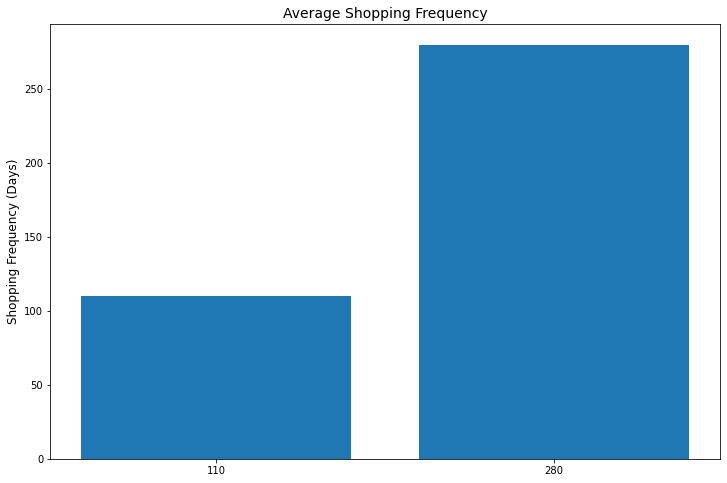

In [158]:

plt.subplots(figsize=(12,8))
plt.bar(x=['Grocery & Gourmet','Home & Kitchen'],height=[110,280])
plt.title('Average Shopping Frequency',fontsize=14)
plt.ylabel('Shopping Frequency (Days)',fontsize=12)
plt.show()

# 

# 

# Task 2

In [144]:
products_g = df_g['asin'].value_counts().head(10).index
products_hk = df_hk['asin'].value_counts().head(10).index

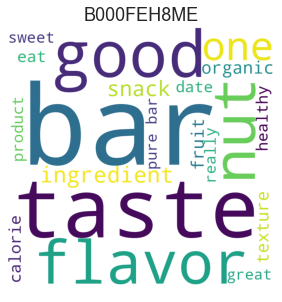

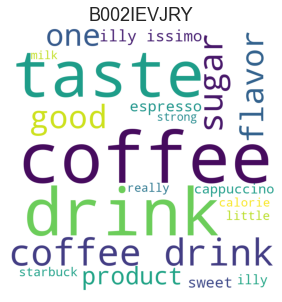

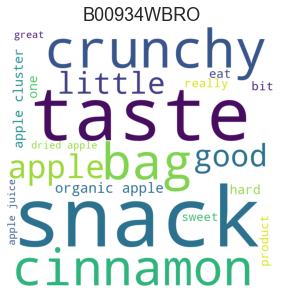

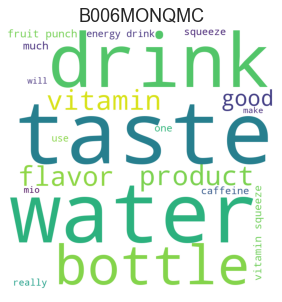

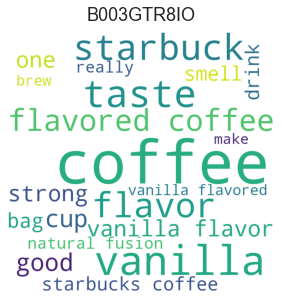

...

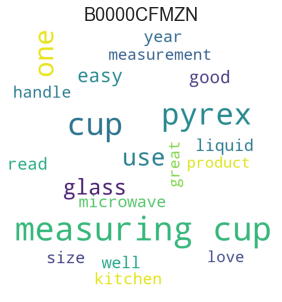

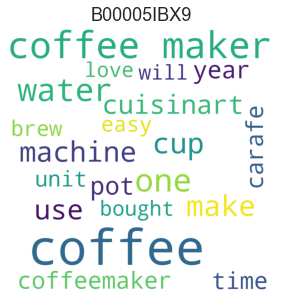

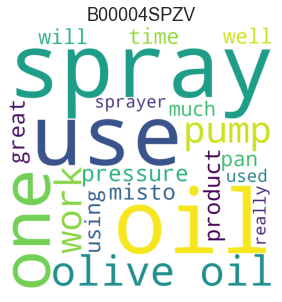

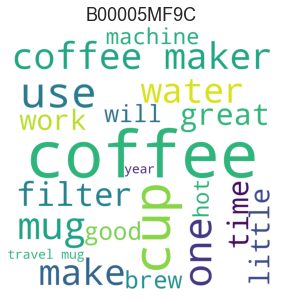

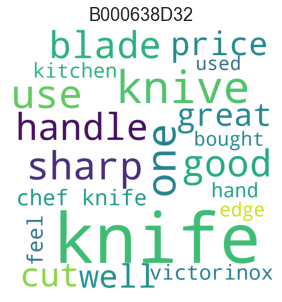

In [145]:
for pid in products_g:
    wc(df_g, pid, 20)

for pid in products_hk:
    wc(df_hk, pid, 20)

In [89]:
dict_g = {products_g[0]:'bar nut',
         products_g[1]:'espresso coffee',
         products_g[2]:'apple crunchy snack',
         products_g[3]:'Vitamin drink',
         products_g[4]:'vanilla coffee',
         products_g[5]:'ginger lemon tea',
         products_g[6]:'chicken meal cheese hamburger',
         products_g[7]:'vanilla tea',
         products_g[8]:'ginger cardamom tea',
         products_g[9]:'chocolate caramel candies',}

dict_hk = {products_hk[0]:'non-stick cook pan',
           products_hk[1]:'popcorn popper machine',
           products_hk[2]:'bowl lid set',
           products_hk[3]:'carpet cleaning machine',
           products_hk[4]:'coffee grinder',
           products_hk[5]:'glass cup',
           products_hk[6]:'coffee maker',
           products_hk[7]:'oil spray',
           products_hk[8]:'coffee mug',
           products_hk[9]:'knife',}

# 

# 

### TSA

In [2]:
import pandas as pd
df_HK=pd.read_csv("capstone_home_final_code.csv")
df_GG=pd.read_csv("capstone_grocery_final_code.csv")

In [8]:
def todatetime(df):
    df['unixReviewTime'] = pd.to_datetime(df['unixReviewTime'])
    df['reviewTime'] = pd.to_datetime(df['reviewTime'])
    return df

df_GG = todatetime(df_GG)
df_HK = todatetime(df_HK)

In [186]:
# def crosstab(df,name):
#     name = pd.crosstab(df['reviewTime'],df['t_Overall_Sentiment'])
#     name = ct_+name.resample('Q').sum()
#     name['total'] = ct_+name['Negative']+ct_+name['Neutral']+ct_+name['Positive']+ct_+name['Strong Negative']+ct_+name['Strong Positive']
#     return name

# ct_GG = crosstab(df_g,'ct_GG')
# ct_HK = crosstab(df_hk,'ct_HK')

In [13]:
# Count of Reviews Over the period of time
ct_HK=pd.crosstab(df_HK['reviewTime'],df_HK['t_Overall_Sentiment'])
ct_HK=ct_HK.resample('Q').sum()
ct_HK['total']=ct_HK['Negative']+ct_HK['Neutral']+ct_HK['Positive']+ct_HK['Strong Negative']+ct_HK['Strong Positive']

ct_GG=pd.crosstab(df_GG['reviewTime'],df_GG['t_Overall_Sentiment'])
ct_GG=ct_GG.resample('Q').sum()
ct_GG['total']=ct_GG['Negative']+ct_GG['Neutral']+ct_GG['Positive']+ct_GG['Strong Negative']+ct_GG['Strong Positive']### TSA

In [14]:
ct_HK = ct_HK[:57]

ss = int(len(ct_HK)*0.90)
train = ct_HK['total'][:ss]
test = ct_HK['total'][ss:]

def checkStationarity(data):
    pvalue = adfuller(data)[1]

    if pvalue < 0.05:
        print('Data is stationary.Proceed to model building')
    else:
        print('Data is not stationary.Difference the data before model building')
        
ss = int(len(ct_HK)*0.90)
train_pos = ct_HK['Positive'][:ss]
test_pos = ct_HK['Positive'][ss:]

In [15]:
ct_GG=ct_GG[:56]

In [58]:
checkStationarity(ct_GG['Positive'].diff(2)[2:])

Data is not stationary.Difference the data before model building


In [34]:
def TSAplots(data=ct_GG['Positive'],train=trainGG_pos,p=1,d=0,q=1,title="Trend of Positive Sentiment Count Grocery & Gourments"):
    m2_pos=ARIMA(train,order=(p,d,q)).fit()
    f2_pos=m2_pos.predict(len(train),len(data)-1)
    new_model_pos=ARIMA(data,order=(p,d,q)).fit()
    fc_pos=new_model_pos.forecast(8)
    plt.subplots(figsize=(12,8))
    plt.plot(data,color='orange',label='Actual')
    plt.plot(fc_pos.combine_first(data[:-2:-1]),color='green',label='Forecast')
    plt.plot(f2_pos,color='blue',label='predicted test')
    plt.title(title,fontsize=14)
    plt.xlabel('Time Period (Quaterly)',fontsize=12)
    plt.ylabel('Count of Sentiment',fontsize=12)
    plt.legend(loc='center')
    


In [25]:
ss=int(len(ct_GG)*0.90)
trainGG_pos=ct_GG['Positive'][:ss]
testGG_pos=ct_GG['Positive'][ss:]

In [51]:
import warnings
warnings.filterwarnings('ignore')

In [59]:
p=[0,1,2,3,4,5,6,7,8]
d=2
q=[0,1,2,3,4,5,6]
dicts={}
for i in p:
    for j in q:
        m2=ARIMA(trainGG_pos,order=(i,d,j)).fit()
        f2=m2.predict(len(trainGG_pos),len(ct_GG)-1)
        RMSE=mean_squared_error(testGG_pos,f2,squared=False)
        #print(i,j,RMSE)
        dicts[i,j]=RMSE
min(dicts,key=dicts.get)

(1, 0)

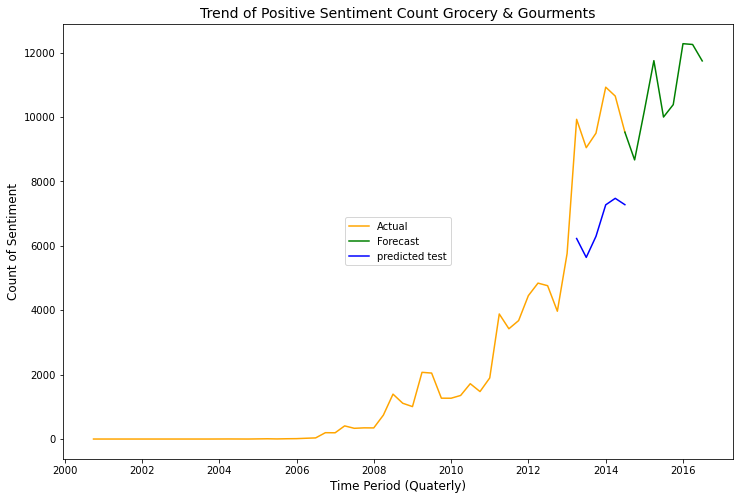

In [60]:
TSAplots(data=ct_GG['Positive'],train=trainGG_pos,p=4,d=2,q=5,title="Trend of Positive Sentiment Count Grocery & Gourments")

In [ ]:
ss=int(len(ct_GG)*0.90)
trainGG_neg=ct_GG['Negative'][:ss]
testGG_neg=ct_GG['Negative'][ss:]

In [61]:
p=[0,1,2,3,4,5,6,7,8]
d=1
q=[0,1,2,3,4,5,6]
dicts={}
for i in p:
    for j in q:
        m2=ARIMA(trainGG_neg,order=(i,d,j)).fit()
        f2=m2.predict(len(trainGG_neg),len(ct_GG)-1)
        RMSE=mean_squared_error(testGG_neg,f2,squared=False)
        #print(i,j,RMSE)
        dicts[i,j]=RMSE
min(dicts,key=dicts.get)

(8, 6)

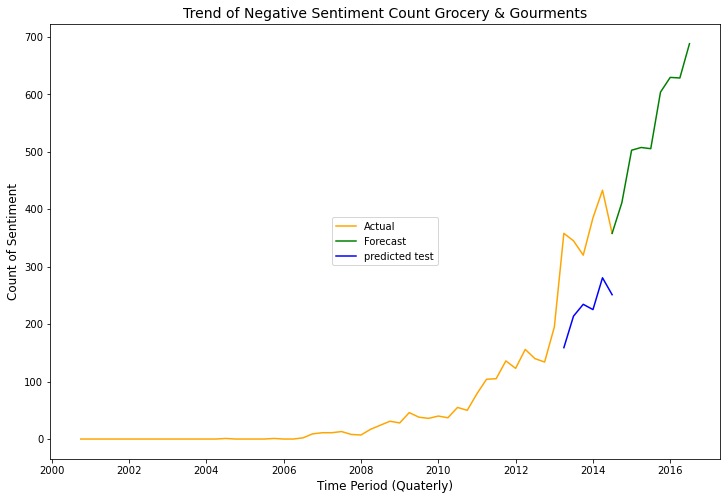

In [63]:
TSAplots(data=ct_GG['Negative'],train=trainGG_neg,p = 4, d = 2, q = 5,title="Trend of Negative Sentiment Count Grocery & Gourments")

In [ ]:
ss=int(len(ct_HK)*0.90)
trainHK_pos=ct_HK['Positive'][:ss]
testHK_pos=ct_HK['Positive'][ss:]

In [65]:
p=[0,1,2,3,4,5,6,7,8]
d=1
q=[0,1,2,3,4,5,6]
dicts={}
for i in p:
    for j in q:
        m2=ARIMA(trainHK_pos,order=(i,d,j)).fit()
        f2=m2.predict(len(trainHK_pos),len(ct_HK)-1)
        RMSE=mean_squared_error(testHK_pos,f2,squared=False)
        #print(i,j,RMSE)
        dicts[i,j]=RMSE
min(dicts,key=dicts.get)

(5, 1)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


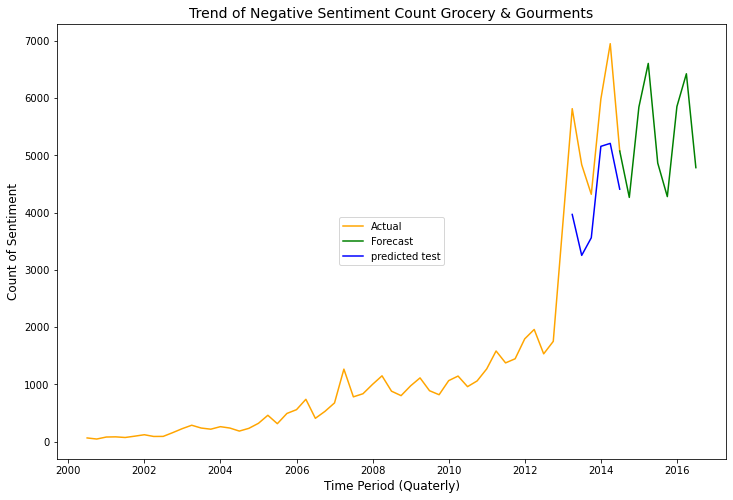

In [41]:
TSAplots(data=ct_HK['Positive'],train=trainHK_pos,p = 5, d = 1, q = 1,title="Trend of Negative Sentiment Count Grocery & Gourments")

In [ ]:
ss=int(len(ct_HK)*0.90)
trainHK_neg=ct_HK['Negative'][:ss]
testHK_neg=ct_HK['Negative'][ss:]

In [67]:
p=[0,1,2,3,4,5,6,7,8]
d=2
q=[0,1,2,3,4,5,6]
dicts={}
for i in p:
    for j in q:
        m2=ARIMA(trainHK_neg,order=(i,d,j)).fit()
        f2=m2.predict(len(trainHK_neg),len(ct_HK)-1)
        RMSE=mean_squared_error(testHK_neg,f2,squared=False)
        #print(i,j,RMSE)
        dicts[i,j]=RMSE
min(dicts,key=dicts.get)

(0, 2)

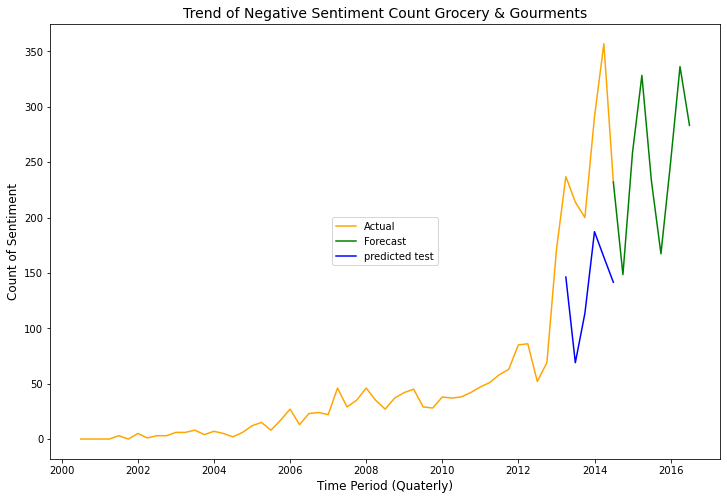

In [69]:
TSAplots(data=ct_HK['Negative'],train=trainHK_neg,p = 3, d = 2, q = 5,title="Trend of Negative Sentiment Count Grocery & Gourments")

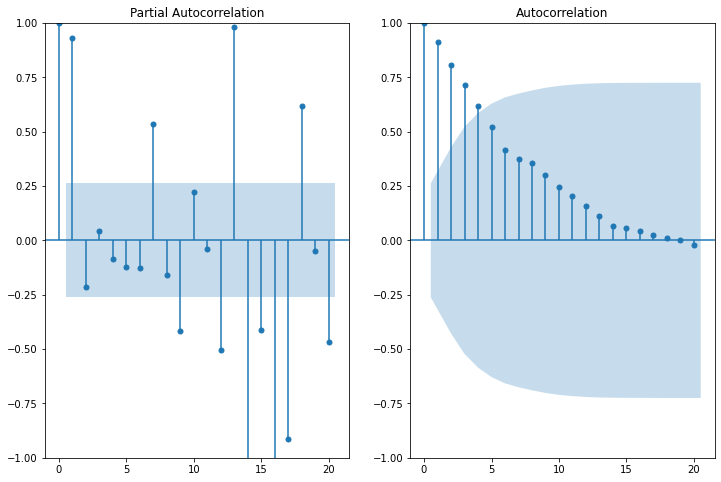

In [42]:
fig,ax=plt.subplots(1,2,figsize=(12,8))

plot_pacf(ct_GG['Positive'],lags=20,ax=ax[0]) ;

plot_acf(ct_GG['Positive'],lags=20,ax=ax[1]);

In [528]:
top5_neg_product_GG=df_GG[(df_GG.r_t_Overall_Sentiment=='Negative')]['asin'].value_counts().head()
top5_neg_product_GG

B005K4Q1YA    12
B0043U63PO    10
B007B9WAH4     9
B006MONQMC     9
B000UUWECC     8
Name: asin, dtype: int64

# 

# 

# Task 4

In [ ]:
common_user=[]
for i in df_GG['reviewerID'].unique():
    if i in (df_HK.reviewerID.unique()):
        common_user.append(i)

In [161]:
GG_unique=set(df_GG['reviewerID'])
HK_unique=set(df_HK.reviewerID)

In [165]:
unique_cust=GG_unique & HK_unique
unique_cust=list(unique_cust)

In [178]:
df_HK[df_HK['reviewerID'].isin(unique_cust)]['reviewText'].count()

17112

In [179]:
df_GG[df_GG['reviewerID'].isin(unique_cust)]['reviewText'].count()

69359

In [180]:
df_HK[df_HK['reviewerID'].isin(unique_cust)]['r_t_Sentiment Score'].mean()

0.21322753671652594

In [181]:
df_GG[df_GG['reviewerID'].isin(unique_cust)]['r_t_Sentiment Score'].mean()

0.2352871754946674

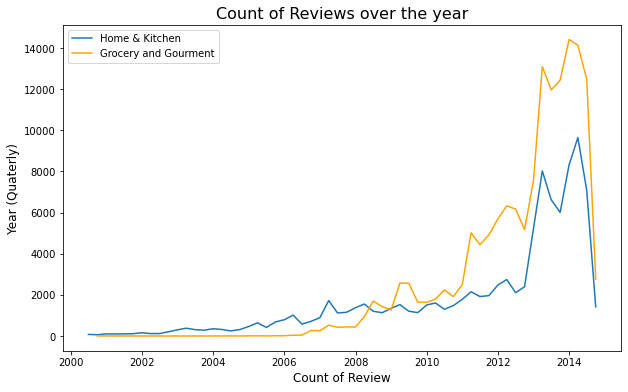

In [8]:
plt.subplots(figsize=(10,6))
plt.plot(ct_HK.index,ct_HK.total,label='Home & Kitchen')
plt.plot(ct_GG.index,ct_GG.total,label='Grocery and Gourment',color='orange')
plt.legend()
plt.title('Count of Reviews over the year',fontsize=16)
plt.xlabel('Count of Review',fontsize=12)
plt.ylabel('Year (Quaterly)',fontsize=12);

In [ ]:
def rat_Quaterly(df):
    rat=df[['overall','reviewTime']]
    rat.set_index('reviewTime',inplace=True)
    rat=rat.resample('Q').mean()
    rat.dropna(inplace=True)
    return rat

rat_GG = rat_Quaterly(df_GG)
rat_HK = rat_Quaterly(df_HK)

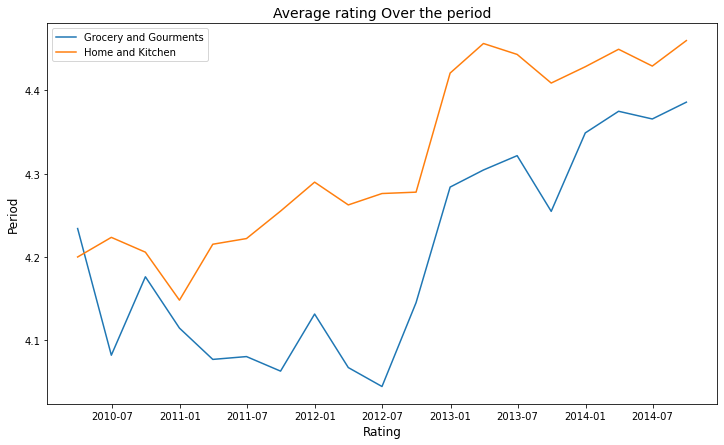

In [11]:
plt.subplots(figsize=(12,7))
plt.plot(rat_GG[:-20:-1],label='Grocery and Gourments')
plt.plot(rat_HK[:-20:-1],label='Home and Kitchen')
plt.title('Average rating Over the period',fontsize=14)
plt.xlabel('Rating',fontsize=12)
plt.ylabel('Period',fontsize=12)
plt.legend();

In [15]:
import matplotlib.pyplot as plt

In [184]:
plt.subplots(figsize=(10,6))
plt.plot(ct_HK.index,ct_HK.total,label='Home & Kitchen')
plt.plot(ct_GG.index,ct_GG.total,label='Grocery and Gourment',color='orange')
plt.legend()
plt.title('Count of Reviews over the year',fontsize=16)
plt.xlabel('Count of Review',fontsize=12)
plt.ylabel('Year (Quaterly)',fontsize=12);import pandas as pd
import gzip

def parse(path):
    g = gzip.open(path, 'rb')
    for l in g:
        yield eval(l)

def getDF(path):
    i = 0
    df = {}
    for d in parse(path):
        df[i] = d
        i += 1
    return pd.DataFrame.from_dict(df, orient='index')

meta_GG = getDF('meta_Grocery_and_Gourmet_Food.json.gz')

In [188]:
meta_GG['also_buy']=meta_GG['also_buy'].apply(lambda x:str(x))

In [196]:
meta_GG['also_buy']=meta_GG['also_buy'].replace('[]', np.nan)

In [198]:
meta_GG.dropna(inplace=True)

In [199]:
meta_GG.head(2)

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
26,"[Grocery & Gourmet Food, Dried Beans, Grains &...",,"[Goya Lentils Pack Of 3, Statements regarding ...",,Goya Lentils / Lentejas / Masoor Dal 16oz (Pac...,"['B00IMLSX76', 'B00Q4007D0', 'B00WBGKJPW', 'B0...",,Goya,[],"242,829 in Grocery & Gourmet Food (","[B001PEZLCW, B004VLVK4O, B00K7XVHRK, B000K8949...",Grocery,,,$20.30,7656543546,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,"{'Shipping Weight:': '2.8 pounds (', 'ASIN: ':..."
28,"[Grocery & Gourmet Food, Beverages]",,"[Produto elaborado com Erva-mate, limo e menta...",,Madrugada Erva-Mate com Lim&atilde;o e Menta T...,"['B01M1N9U23', 'B00GDIKW2E', 'B00N31FTWC', 'B0...",,Madrugada,[],"384,118 in Grocery & Gourmet Food (",[],Grocery,,,,7656453768,[],[],"{'Shipping Weight:': '1.2 pounds', 'ASIN: ': '..."


In [212]:
meta_GG[meta_GG.asin=='B00028PVHW']

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
3096,"[Grocery & Gourmet Food, Herbs, Spices & Seaso...",,[Vege-Sal Spike Natural Seasoning Original VEG...,,Vege-Sal Spike Natural Seasoning Original VEGE...,"['B00H4I8MA6', 'B002LO5SFA', 'B00CQ7YWCW', 'B0...",,Gaylord Hauser,[],"40,199 in Grocery & Gourmet Food (","[B00H4I8MA6, B000LKYXUC, B002LO5SFA, B0041Q7GD...",Grocery,,,$8.51,B00028PVHW,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,{' Product Dimensions: ': '1.8 x 3 x ...
6793,"[Grocery & Gourmet Food, Herbs, Spices & Seaso...",,[Vege-Sal Spike Natural Seasoning Original VEG...,,Vege-Sal Spike Natural Seasoning Original VEGE...,"['B00H4I8MA6', 'B002LO5SFA', 'B00CQ7YWCW', 'B0...",,Gaylord Hauser,[],"40,199 in Grocery & Gourmet Food (","[B00H4I8MA6, B000LKYXUC, B002LO5SFA, B0041Q7GD...",Grocery,,,$8.51,B00028PVHW,[https://images-na.ssl-images-amazon.com/image...,[https://images-na.ssl-images-amazon.com/image...,{' Product Dimensions: ': '1.8 x 3 x ...


In [ ]:
idx=meta_GG.asin.drop_duplicates(keep='first').index

In [234]:
meta_GG=meta_GG[meta_GG.index.isin(idx)]

In [241]:
import ast
meta_GG['also_buy']=meta_GG['also_buy'].apply(lambda x:ast.literal_eval(x))

In [242]:
li=[]
for i in meta_GG.also_buy:
    li.extend(i)

In [260]:
HK_uniqueASIN=list(set(df_HK.asin))

In [267]:
counts={}
count=0
for i in HK_uniqueASIN:
    for j in meta_GG['also_buy']:    
        if i in j:
            count=+1
    counts[i]=count


In [288]:
len(set(li))

293028

In [284]:
len(meta_GG['also_buy'])

82264

In [275]:
len(HK_uniqueASIN)

3957

In [1]:
import pandas as pd
import gzip

def parse(path):
    g=gzip.open(path,'rb')
    for l in g:
        yield eval(l)

def getDF(path):
    i=0
    df={}
    for d in parse(path):
        df[i]=d
        i+=1
    return pd.DataFrame.from_dict(df,orient='index')

df= getDF('reviews_Home_and_Kitchen_5.json.gz')

In [2]:
df=df[:100000]
df['reviewTime']=pd.to_datetime(df['reviewTime'])
df1=df.sort_values(by=['reviewerID','reviewTime'])
df1.head()

,reviewerID,asin,reviewerName,helpful,reviewText,overall,summary,unixReviewTime,reviewTime
11654,A0002382258OFJJ2UYNTR,B00004S7YF,PreacherGurl,"[0, 0]",I bought this to start my new hobby of baking ...,5.0,Funnn.,1366156800,2013-04-17
19357,A0010876CNE3ILIM9HV0,B00004W4UL,JassyR,"[0, 0]",I bought this so we wouldn't keep breaking our...,4.0,Nordic Ware Compact Bacon Rack,1386201600,2013-12-05
48890,A0010876CNE3ILIM9HV0,B00008W70I,JassyR,"[0, 0]",I bought two of these and I love them! I bake ...,5.0,Great Nonstick Pan,1391385600,2014-02-03
35383,A00473363TJ8YSZ3YAGG9,B000063SKU,Thomas Rogers,"[0, 1]",I'm not a fan of T-fal but this pizza nonstick...,5.0,AirBake Ultra by T-fal T481BNN2 Insulated Nons...,1393372800,2014-02-26
62326,A00593903MCE5GXTAGGNL,B0000CFMZN,Kenny L,"[0, 0]",This Pyrex 2-Cup Measuring Cup should be a par...,5.0,Just What I Needed,1391904000,2014-02-09


In [4]:
# extract the dates for each customer when they purchased for the first time
purchase1=df1.groupby('reviewerID')['reviewTime'].min()

purchase1=pd.DataFrame(purchase1)
purchase1.reset_index(inplace=True)
purchase1

,reviewerID,reviewTime
0,A0002382258OFJJ2UYNTR,2013-04-17
1,A0010876CNE3ILIM9HV0,2013-12-05
2,A00473363TJ8YSZ3YAGG9,2014-02-26
3,A00593903MCE5GXTAGGNL,2014-02-09
4,A0145698H8AAYMRXLBD8,2013-11-18
...,...,...
44893,AZZQX6PBTG4GW,2013-08-21
44894,AZZRRYBQG57LF,2013-06-29
44895,AZZTC2OYVNE2Q,2012-12-27
44896,AZZV9PDNMCOZW,2011-07-12


In [5]:
# extract the dates for each customer when they purchased for the last time
purchase2=df1.groupby('reviewerID')['reviewTime'].max()
purchase2=pd.DataFrame(purchase2)
purchase2.reset_index(inplace=True)
purchase2

,reviewerID,reviewTime
0,A0002382258OFJJ2UYNTR,2013-04-17
1,A0010876CNE3ILIM9HV0,2014-02-03
2,A00473363TJ8YSZ3YAGG9,2014-02-26
3,A00593903MCE5GXTAGGNL,2014-02-09
4,A0145698H8AAYMRXLBD8,2013-11-18
...,...,...
44893,AZZQX6PBTG4GW,2013-08-21
44894,AZZRRYBQG57LF,2013-09-29
44895,AZZTC2OYVNE2Q,2012-12-27
44896,AZZV9PDNMCOZW,2011-07-12


In [8]:
#count of products bought
from functools import reduce
frequency=df1.groupby('reviewerID')['reviewerID'].count()
frequency=pd.DataFrame(frequency)
frequency.rename(columns={'reviewerID':'Count'},inplace=True)
frequency.reset_index(inplace=True)
new_df1=reduce(lambda x,y: pd.merge(x,y,on=['reviewerID']),[purchase1,purchase2,frequency])
new_df1.head()

,reviewerID,reviewTime_x,reviewTime_y,Count
0,A0002382258OFJJ2UYNTR,2013-04-17,2013-04-17,1
1,A0010876CNE3ILIM9HV0,2013-12-05,2014-02-03,2
2,A00473363TJ8YSZ3YAGG9,2014-02-26,2014-02-26,1
3,A00593903MCE5GXTAGGNL,2014-02-09,2014-02-09,1
4,A0145698H8AAYMRXLBD8,2013-11-18,2013-11-18,1


In [9]:
new_df1['Difference']=(new_df1['reviewTime_y']-new_df1['reviewTime_x'])
new_df1.head()

,reviewerID,reviewTime_x,reviewTime_y,Count,Difference
0,A0002382258OFJJ2UYNTR,2013-04-17,2013-04-17,1,0 days
1,A0010876CNE3ILIM9HV0,2013-12-05,2014-02-03,2,60 days
2,A00473363TJ8YSZ3YAGG9,2014-02-26,2014-02-26,1,0 days
3,A00593903MCE5GXTAGGNL,2014-02-09,2014-02-09,1,0 days
4,A0145698H8AAYMRXLBD8,2013-11-18,2013-11-18,1,0 days


In [12]:
# filtering for the customers who have shopped atleast twice on amazon
multiple_shop=new_df1[new_df1['Difference']!='0 days']
multiple_shop['Shopping_freq']=multiple_shop['Difference']/multiple_shop['Count']
multiple_shop.head()

C:\Users\91830\AppData\Local\Temp\ipykernel_16796\449343619.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multiple_shop['Shopping_freq']=multiple_shop['Difference']/multiple_shop['Count']


,reviewerID,reviewTime_x,reviewTime_y,Count,Difference,Shopping_freq
1,A0010876CNE3ILIM9HV0,2013-12-05,2014-02-03,2,60 days,30 days 00:00:00
9,A03756272FRRX98COZNG7,2013-08-30,2013-12-31,2,123 days,61 days 12:00:00
10,A04740333HUOPRGNFV2HM,2014-04-23,2014-07-08,2,76 days,38 days 00:00:00
24,A100L918633LUO,2013-09-25,2014-02-26,7,154 days,22 days 00:00:00
26,A100WO06OQR8BQ,2008-04-04,2014-03-05,2,2161 days,1080 days 12:00:00


In [13]:
#Average purchase frequency
print('The average purchase frequency for Home and Kitchen Category is : ',multiple_shop['Shopping_freq'].mean())

The average purchase frequency for Home and Kitchen Category is :  280 days 14:59:58.199075324


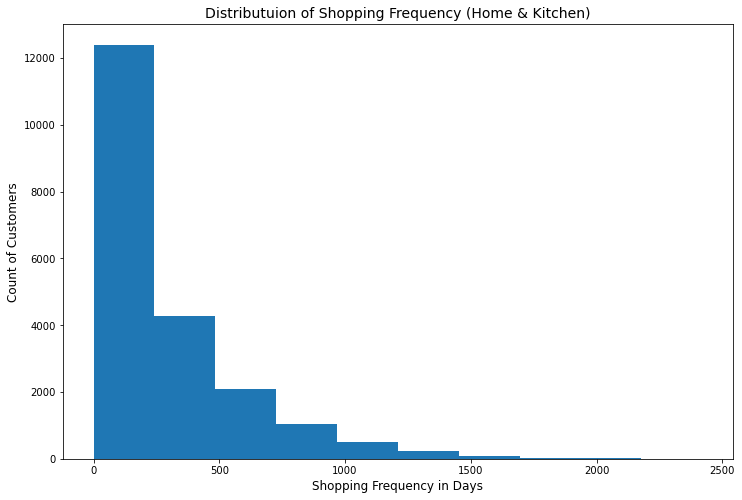

In [16]:
#Distribution of purchase frequency
_,ax=plt.subplots(1,1,figsize=(12,8))
plt.hist(multiple_shop['Shopping_freq'].apply(lambda x:x.days))
plt.ylabel('Count of Customers',fontsize=12)
plt.xlabel('Shopping Frequency in Days',fontsize=12)
plt.title('Distributuion of Shopping Frequency (Home & Kitchen)',fontsize=14)
plt.show()

In [18]:
multiple_shop['frequency_days']=multiple_shop['Shopping_freq'].apply(lambda x:x.days)
analysis_11=multiple_shop.copy()
analysis=multiple_shop['frequency_days']>280
analysis.value_counts()
# To find out the count of customers who have purchase frequency greater than average purchase frequency for Home and Kitchen categoty

C:\Users\91830\AppData\Local\Temp\ipykernel_16796\508933786.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multiple_shop['frequency_days']=multiple_shop['Shopping_freq'].apply(lambda x:x.days)


False    13325
True      7359
Name: frequency_days, dtype: int64

In [19]:
#replacing the values greater than average purchase frquency by the average value that is 280 days
analysis_11.loc[analysis_11['frequency_days']>280,'frequency_days']=280

In [20]:
print('After replacing the purchase frequency greater than 280 days by 280 days, the value drops to: ',analysis_11['frequency_days'].mean())

After replacing the purchase frequency greater than 280 days by 280 days, the value drops to:  165.6494875265906


In [ ]:
#Count of Target Customers(Home and Kitchen): 7359
#Total Customers(Home and Kitchen):20684

#35.57% of the customers shopping from Home and Kitchen category have a shooping frequency greater than the average shopping 
#frequency of 280 days.

# To further reduce the overall shopping frequency , we should target these customers and if we manage to reduce this number to 
# 280 days then the overall shopping frequency would reduce to 166 days.

In [21]:
def parse(path):
    g=gzip.open(path,'rb')
    for l in g:
        yield eval(l)

def getDF(path):
    i=0
    df={}
    for d in parse(path):
        df[i]=d
        i+=1
    return pd.DataFrame.from_dict(df,orient='index')

df_gro= getDF('reviews_Grocery_and_Gourmet_Food_5.json.gz')

In [22]:
df_gro['reviewTime']=pd.to_datetime(df_gro['reviewTime'])
df_gro=df_gro.sort_values(by=['reviewerID','reviewTime'])
# extract the dates for each customer when they purchased for the first time
purchase1=df_gro.groupby('reviewerID')['reviewTime'].min()

purchase1=df_gro.groupby('reviewerID')['reviewTime'].min()
purchase1=pd.DataFrame(purchase1)
purchase1.reset_index(inplace=True)
purchase1

,reviewerID,reviewTime
0,A00177463W0XWB16A9O05,2013-01-06
1,A022899328A0QROR32DCT,2012-12-29
2,A04309042SDSL8YX2HRR7,2013-04-14
3,A068255029AHTHDXZURNU,2014-05-04
4,A06944662TFWOKKV4GJKX,2013-10-12
...,...,...
14676,AZWRZZAMX90VT,2006-08-29
14677,AZXKAH2DE6C8A,2010-01-23
14678,AZXON596A1VXC,2009-09-03
14679,AZYXC63SS008M,2011-09-29


In [23]:
# extract the dates for each customer when they purchased for the last time
purchase2=df_gro.groupby('reviewerID')['reviewTime'].max()
purchase2=pd.DataFrame(purchase2)
purchase2.reset_index(inplace=True)
purchase2

,reviewerID,reviewTime
0,A00177463W0XWB16A9O05,2013-04-01
1,A022899328A0QROR32DCT,2014-07-09
2,A04309042SDSL8YX2HRR7,2013-12-05
3,A068255029AHTHDXZURNU,2014-07-11
4,A06944662TFWOKKV4GJKX,2013-11-01
...,...,...
14676,AZWRZZAMX90VT,2012-09-19
14677,AZXKAH2DE6C8A,2014-04-06
14678,AZXON596A1VXC,2013-02-08
14679,AZYXC63SS008M,2013-09-19


In [24]:
frequency=df_gro.groupby('reviewerID')['reviewerID'].count()
frequency=pd.DataFrame(frequency)
frequency.rename(columns={'reviewerID':'Count'},inplace=True)
frequency.reset_index(inplace=True)

In [25]:
new_df2=reduce(lambda x,y: pd.merge(x,y,on=['reviewerID']),[purchase1,purchase2,frequency])
new_df2

,reviewerID,reviewTime_x,reviewTime_y,Count
0,A00177463W0XWB16A9O05,2013-01-06,2013-04-01,13
1,A022899328A0QROR32DCT,2012-12-29,2014-07-09,10
2,A04309042SDSL8YX2HRR7,2013-04-14,2013-12-05,5
3,A068255029AHTHDXZURNU,2014-05-04,2014-07-11,9
4,A06944662TFWOKKV4GJKX,2013-10-12,2013-11-01,9
...,...,...,...,...
14676,AZWRZZAMX90VT,2006-08-29,2012-09-19,23
14677,AZXKAH2DE6C8A,2010-01-23,2014-04-06,25
14678,AZXON596A1VXC,2009-09-03,2013-02-08,7
14679,AZYXC63SS008M,2011-09-29,2013-09-19,6


In [26]:
new_df2['Difference']=(new_df2['reviewTime_y']-new_df2['reviewTime_x'])
multiple_shop=new_df2[new_df2['Difference']!='0 days']
multiple_shop['Shopping_freq']=multiple_shop['Difference']/multiple_shop['Count']
multiple_shop

C:\Users\91830\AppData\Local\Temp\ipykernel_16796\2717460743.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multiple_shop['Shopping_freq']=multiple_shop['Difference']/multiple_shop['Count']


,reviewerID,reviewTime_x,reviewTime_y,Count,Difference,Shopping_freq
0,A00177463W0XWB16A9O05,2013-01-06,2013-04-01,13,85 days,6 days 12:55:23.076923076
1,A022899328A0QROR32DCT,2012-12-29,2014-07-09,10,557 days,55 days 16:48:00
2,A04309042SDSL8YX2HRR7,2013-04-14,2013-12-05,5,235 days,47 days 00:00:00
3,A068255029AHTHDXZURNU,2014-05-04,2014-07-11,9,68 days,7 days 13:20:00
4,A06944662TFWOKKV4GJKX,2013-10-12,2013-11-01,9,20 days,2 days 05:20:00
...,...,...,...,...,...,...
14676,AZWRZZAMX90VT,2006-08-29,2012-09-19,23,2213 days,96 days 05:13:02.608695652
14677,AZXKAH2DE6C8A,2010-01-23,2014-04-06,25,1534 days,61 days 08:38:24
14678,AZXON596A1VXC,2009-09-03,2013-02-08,7,1254 days,179 days 03:25:42.857142857
14679,AZYXC63SS008M,2011-09-29,2013-09-19,6,721 days,120 days 04:00:00


In [27]:
#Average purchase frequency
print('The average purchase frequency for Grocery and Gourmet Category is : ',multiple_shop['Shopping_freq'].mean())

The average purchase frequency for Grocery and Gourmet Category is :  110 days 03:55:56.988686868


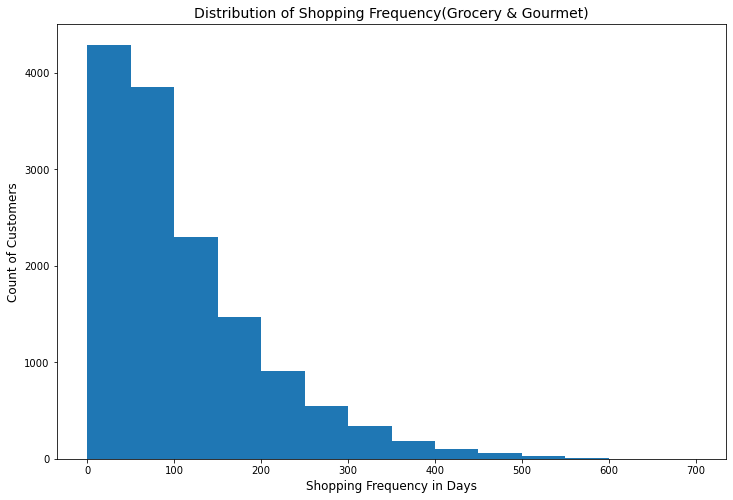

In [28]:
_,ax=plt.subplots(1,1,figsize=(12,8))
plt.hist(multiple_shop['Shopping_freq'].apply(lambda x:x.days),bins=[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700])
plt.ylabel('Count of Customers',fontsize=12)
plt.xlabel('Shopping Frequency in Days',fontsize=12)
plt.title('Distribution of Shopping Frequency(Grocery & Gourmet)',fontsize=14)
plt.show()

In [29]:
multiple_shop['frequency_days']=multiple_shop['Shopping_freq'].apply(lambda x:x.days)
analysis_1=multiple_shop['frequency_days']>110
analysis_1.value_counts()

C:\Users\91830\AppData\Local\Temp\ipykernel_16796\2812709734.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  multiple_shop['frequency_days']=multiple_shop['Shopping_freq'].apply(lambda x:x.days)


False    8753
True     5352
Name: frequency_days, dtype: int64

In [30]:
analysis_1=multiple_shop.copy()
analysis_1.loc[analysis_1['frequency_days']>110,'frequency_days']=110
analysis_1

,reviewerID,reviewTime_x,reviewTime_y,Count,Difference,Shopping_freq,frequency_days
0,A00177463W0XWB16A9O05,2013-01-06,2013-04-01,13,85 days,6 days 12:55:23.076923076,6
1,A022899328A0QROR32DCT,2012-12-29,2014-07-09,10,557 days,55 days 16:48:00,55
2,A04309042SDSL8YX2HRR7,2013-04-14,2013-12-05,5,235 days,47 days 00:00:00,47
3,A068255029AHTHDXZURNU,2014-05-04,2014-07-11,9,68 days,7 days 13:20:00,7
4,A06944662TFWOKKV4GJKX,2013-10-12,2013-11-01,9,20 days,2 days 05:20:00,2
...,...,...,...,...,...,...,...
14676,AZWRZZAMX90VT,2006-08-29,2012-09-19,23,2213 days,96 days 05:13:02.608695652,96
14677,AZXKAH2DE6C8A,2010-01-23,2014-04-06,25,1534 days,61 days 08:38:24,61
14678,AZXON596A1VXC,2009-09-03,2013-02-08,7,1254 days,179 days 03:25:42.857142857,110
14679,AZYXC63SS008M,2011-09-29,2013-09-19,6,721 days,120 days 04:00:00,110


In [31]:
print('After replacing the purchase frequency greater than 110 days by 110 days, the value drops to: ',analysis_1['frequency_days'].mean())

After replacing the purchase frequency greater than 110 days by 110 days, the value drops to:  73.77171215880894


In [ ]:
#Count of Target Customers(Grocery and Gourmet): 5352
#Total Customers(Grocery and Gourmet):14105

#37.9% of the customers shopping from Grocery and Gourmet category have a shooping frequency greater than the average shopping 
#frequency of 110 days.

# To further reduce the overall shopping frequency , we should target these customers and if we manage to reduce this number to 
# 110 days then the overall shopping frequency would reduce to 74 days.

In [32]:
# Common Customers

common_cust=list(set(df['reviewerID'])& set(df_gro['reviewerID']))

print('The count of customers common to both categories is: ',len(common_cust))

The count of customers common to both categories is:  4987


In [34]:
# top 5  common customers who shopped most frequently

max_common_cust=df_gro[df_gro['reviewerID'].isin(common_cust)][['reviewerID','reviewerName']].value_counts().head()
print(max_common_cust)
k=pd.DataFrame(max_common_cust.index)
ids=[]
for i in range(len(k)):
    ids.append(k[0][i][0])

reviewerID      reviewerName  
A3OXHLG6DIBRW8  C. Hill "CFH"     203
AY12DBB0U420B   Gary Peterson     180
A2XKJ1KX6XUHYP  NYFB              177
A1UQBFCERIP7VJ  Margaret Picky    156
AAA0TUKS5VBSA   Nerd Alert        148
dtype: int64


In [35]:
common_gro=df_gro[df_gro['reviewerID'].isin(common_cust)][['reviewerID','reviewerName']].value_counts()
common_gro=pd.DataFrame(common_gro)
common_gro.reset_index(inplace=True)
common_gro['Products Bought from GG']=common_gro[0]
common_gro.drop(0,1,inplace=True)
common_gro

C:\Users\91830\AppData\Local\Temp\ipykernel_16796\2991939009.py:5: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  common_gro.drop(0,1,inplace=True)


,reviewerID,reviewerName,Products Bought from GG
0,A3OXHLG6DIBRW8,"C. Hill ""CFH""",203
1,AY12DBB0U420B,Gary Peterson,180
2,A2XKJ1KX6XUHYP,NYFB,177
3,A1UQBFCERIP7VJ,Margaret Picky,156
4,AAA0TUKS5VBSA,Nerd Alert,148
...,...,...,...
5003,A2CQIWHK4CKTGZ,Carol S.,1
5004,A3PEOF0GX4EN38,"Carolyn Rampone ""Carolyn D'Amico Rampone""",1
5005,A17V2N0N8CXSA9,"ILuvBC ""James Bay""",1
5006,AW9T67ASOEMJQ,"Cherubian ""cherubian""",1


In [36]:
common_hk=df[df['reviewerID'].isin(common_cust)][['reviewerID','reviewerName']].value_counts()
common_hk=pd.DataFrame(common_hk)
common_hk.reset_index(inplace=True)
common_hk['Products Bought from HK']=common_hk[0]
common_hk.drop(0,1,inplace=True)
common_hk

C:\Users\91830\AppData\Local\Temp\ipykernel_16796\2351827345.py:5: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  common_hk.drop(0,1,inplace=True)


,reviewerID,reviewerName,Products Bought from HK
0,A1IU7S4HCK1XK0,Joanna Daneman,99
1,AXO4PQU0XG3TG,Dwight,81
2,A23GFTVIETX7DS,Debbie Lee Wesselmann,53
3,A1KXONFPU2XQ5K,Stephanie Manley,49
4,A1Z54EM24Y40LL,csm,48
...,...,...,...
4974,A3O5UR6NHR4MRP,Amazon Customer,1
4975,A2AVMEB8PQOTTE,"Robert Riggs ""The Music Connection Wholesale""",1
4976,A3O28W281QXPNE,CeesMom,1
4977,A2AWZ10ZWPJUXC,Gee,1


In [37]:
new_common=pd.merge(common_gro,common_hk,on=['reviewerID','reviewerName'])
new_common['Total']=new_common['Products Bought from GG']+new_common['Products Bought from HK']
new_common=new_common.sort_values('Total',ascending=False)
new_common

,reviewerID,reviewerName,Products Bought from GG,Products Bought from HK,Total
0,A3OXHLG6DIBRW8,"C. Hill ""CFH""",203,19,222
1,AY12DBB0U420B,Gary Peterson,180,9,189
7,A1Z54EM24Y40LL,csm,140,48,188
2,A2XKJ1KX6XUHYP,NYFB,177,5,182
6,A25C2M3QF9G7OQ,Comdet,140,31,171
...,...,...,...,...,...
4955,A2DSG6MYAPEPGY,eilene44,4,1,5
4959,A1LUK8APLC16WK,"Lynne Hersh ""kellysmom""",4,1,5
4972,A3O0N562BLZ4Y8,Dave,3,1,4
4974,A2KD9EDKK7LVTI,afterlife,2,1,3


In [38]:
count_li=list(zip(new_common['Products Bought from GG'],new_common['Products Bought from HK']))
a=0
for i,j in count_li:
    if i>j:
        a=a+1
print('The count of customers who have bought more products from the GG compared to HK are: ',a)


The count of customers who have bought more products from the GG compared to HK are:  4702


In [41]:
print('% of the customers shopping from the both the categories who buy more products from the GG category are: ',a/len(common_cust))

% of the customers shopping from the both the categories who buy more products from the GG category are:  0.9428514136755565
